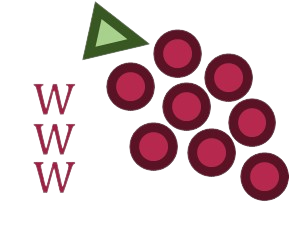

# <font color='#5E2190'>*World Wines of the World*'s Segmentations

DMDM 22/23

Professor Fernando Bação

GROUP049 * Raimundo Mujica Costa, 20221342   ** Simão Pedro Accioli Gouveia dos Santos, 20220561  *** Tomas Caldeira Cardoso Soares Esteves, 20220073

# <font color='#5E2190'>Abstract

**In this notebook, the group implemented the necessary algorithms to achive a segmentation for both Wonderful Wines of the World Client's Profile and their Buying Behaviour.**

**The notebook assembles all the processes required to perform in order to achieve the last mentioned goal, namely:**

**1.** a check on the dataset's coherence and it's visualization,

**2.** the process of selecting the crucial variables to enter the segmentation process,

**3.** the preparation of the data where we unveiled some of the data's problems and try to minimize their impact on the following clustering process,

**4.** the segmentations assembly itself,

**5.** and a segmentation polishing, so the outcomes of the segmentation are more evident to a practical marketing approach.

**In the end we'll have reached a segmentation of 11 groups that, on a later stage were arranged and are going to be the foundations for some suggestions on marketing approaches (report only).**

# <font color='#5E2190'>Index</font> <a class="anchor" id="toc"></a>
* [1. Initialization](#Initialization)
* [2. Data Integrity Evaluation, Requisites Confirmation and Visualization](#Integrity)
* [3. Data Pre-Processing](#Proccesing)
* [4. Clustering](#Clustering)
* [5. Merging Both Cluster Segmentations](#Merge)
* [6. Deciding the Target Groups](#Comment)

# <font color='#5E2190'>1. Initialization</font> <a class="anchor" id="Initialization"></a>
**The group starts the project by assembling all the requirements to the project development.**

**We also create two initial basis to approach both required segmentations.**

[To Index](#toc) 

## 1.1 Install and import packages
On this chapter the group reconfigurates the notebook specs.

In [1]:
#Install packages
!pip install pandas_profiling==3.3.0
!pip install numpy
!pip install matplotlib
!pip install seaborn
!pip install pandas_profiling
!pip install ipywidgets
!pip install Scikit-learn
!pip install openpyxl
!pip install jupyter_helpers
!pip3 install ipywidgets
!pip3 install scipy
!pip3 install graphviz
!pip3 install plotly

## Importing python packages
import pandas as pd
import numpy as np
import seaborn as sns
import math as mat
import matplotlib.pyplot as plt
import scipy.stats as stats
from collections import Counter
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from sklearn.cluster import KMeans, MeanShift, estimate_bandwidth, AgglomerativeClustering, DBSCAN
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.base import clone
from sklearn.metrics import pairwise_distances
from sklearn.manifold import TSNE
from sklearn.experimental import enable_iterative_imputer
from os.path import join
from mpl_toolkits.mplot3d import Axes3D
import graphviz
import openpyxl
import scipy.cluster.hierarchy as shc
from joblib import dump
from math import pi
from math import ceil
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D
from jupyter_helpers.notifications import Notifications

## Some configuration
%matplotlib inline

# for better resolution plots
%config InlineBackend.figure_format = 'retina'

# Set seaborn style
sns.set()

## 1.2 Read Dataset and Initial Subdataset Division
Data reading and Initial Divisions based on project approach

In [2]:
#original dataset reading and opening
full_initial_dataset = pd.read_excel('WonderfulWinesWorld_Clustering_DMDM2022e23.xlsx')
full_initial_dataset

,Custid,Dayswus,Age,Educ,Income,Kidhome,Teenhome,Freq,Recency,Monetary,...,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access
0,1001,789,68,16,90782,0,0,29,66,1402,...,3,37,5,44,10,3,2,19,4,1
1,1002,623,78,20,113023,0,0,31,6,1537,...,1,55,1,38,4,2,2,9,1,0
2,1003,583,24,18,28344,1,0,4,69,44,...,66,32,19,24,1,24,63,59,7,1
3,1004,893,59,19,93571,0,1,21,10,888,...,12,60,10,19,6,5,15,35,5,0
4,1005,1062,59,18,91852,0,1,25,26,1138,...,5,59,5,28,4,4,19,34,6,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,10996,967,28,17,54292,0,0,23,72,1011,...,7,41,11,36,1,11,42,31,6,0
9996,10997,637,76,15,125962,0,1,33,75,1668,...,3,61,2,25,5,6,1,45,5,2
9997,10998,586,69,19,99628,0,0,30,98,1469,...,2,46,0,29,11,14,4,18,3,0
9998,10999,598,65,14,111018,1,0,28,4,1350,...,4,48,16,27,8,1,8,36,4,0


In [3]:
#data's variable types check
full_initial_dataset.dtypes

Custid         int64
Dayswus        int64
Age            int64
Educ           int64
Income         int64
Kidhome        int64
Teenhome       int64
Freq           int64
Recency        int64
Monetary       int64
LTV            int64
Perdeal        int64
Dryred         int64
Sweetred       int64
Drywh          int64
Sweetwh        int64
Dessert        int64
Exotic         int64
WebPurchase    int64
WebVisit       int64
Access         int64
dtype: object

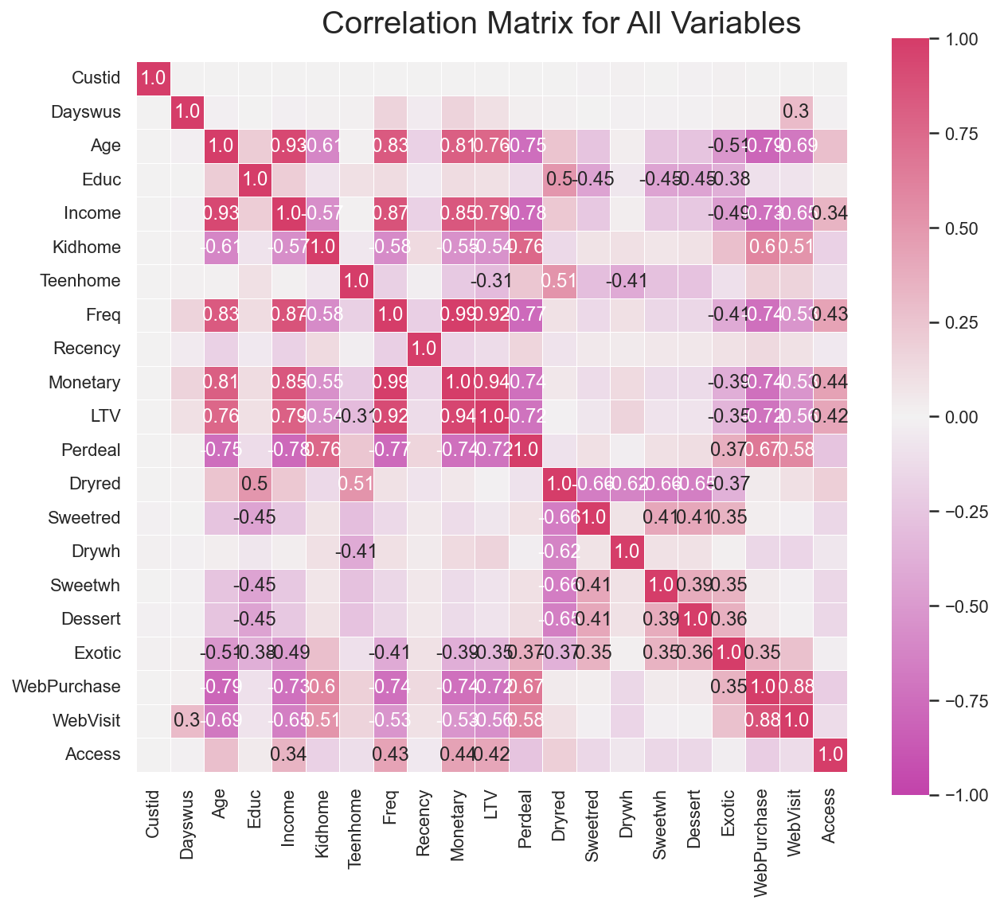

In [4]:
#ploting Pearson's Correlation Matrix for all variables
fig = plt.figure(figsize=(10, 8))

corr = np.round(full_initial_dataset.corr(method="pearson"), decimals=2)

mask_annot = np.absolute(corr.values) >= 0.3
annot = np.where(mask_annot, corr.values, np.full(corr.shape,""))

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(320, 360, as_cmap=True), 
fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=0.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix for All Variables ", fontsize=20)

plt.show()

Observing the high correlation between variables Freq and Monetary and acknowledging they refer to the same period of time,
we decide to create a new variable: AVRPUR (Average Purchase)

In [5]:
#check occurences with value 0 of variable FREQ for new variable viability
(full_initial_dataset['Freq']==0).sum()
#AVRPUR definition
full_initial_dataset['AVRPUR'] = round(full_initial_dataset['Monetary'] / full_initial_dataset['Freq'], 2)
full_initial_dataset

,Custid,Dayswus,Age,Educ,Income,Kidhome,Teenhome,Freq,Recency,Monetary,...,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access,AVRPUR
0,1001,789,68,16,90782,0,0,29,66,1402,...,37,5,44,10,3,2,19,4,1,48.34
1,1002,623,78,20,113023,0,0,31,6,1537,...,55,1,38,4,2,2,9,1,0,49.58
2,1003,583,24,18,28344,1,0,4,69,44,...,32,19,24,1,24,63,59,7,1,11.00
3,1004,893,59,19,93571,0,1,21,10,888,...,60,10,19,6,5,15,35,5,0,42.29
4,1005,1062,59,18,91852,0,1,25,26,1138,...,59,5,28,4,4,19,34,6,0,45.52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,10996,967,28,17,54292,0,0,23,72,1011,...,41,11,36,1,11,42,31,6,0,43.96
9996,10997,637,76,15,125962,0,1,33,75,1668,...,61,2,25,5,6,1,45,5,2,50.55
9997,10998,586,69,19,99628,0,0,30,98,1469,...,46,0,29,11,14,4,18,3,0,48.97
9998,10999,598,65,14,111018,1,0,28,4,1350,...,48,16,27,8,1,8,36,4,0,48.21


We divide the variables set into 3 different groups, believing this is make much more clear the path we have to follow

In [6]:
#all variables are considered metric variables with the exception of Kidhome and Teenhome
socio_demographic = ['Age', 'Educ', 'Income', 'Kidhome', 'Teenhome']
customer_practices = ['Dayswus', 'Freq', 'Recency', 'Monetary', 'AVRPUR', 'LTV', 'Perdeal', 'WebPurchase', 'WebVisit']
purchase_composition = ['Dryred', 'Sweetred', 'Drywh', 'Sweetwh', 'Dessert', 'Exotic', 'Access']

Consequently, we are now able to define an initial dataset variables division to approach both required segmentations.

In [7]:
#defining datasets for both segmentations: Client Profile and Buying Behaviour
#CustomerID doesn't go in any of the segmentation datasets
clientprofile_initial_variables = socio_demographic + customer_practices

Although it could be directly defined within the the datasets creation, we aggroupate the already created lists as it can be useful on a later stage.

Concerning the Buying Behaviour segmentation, the group is still in doubt between two aprroaches.

Approach1: consider buyingbehaviour variables as the combination of both socio_demographic and customer_practices groups.

Approach2: consider solo customer_practices.

* [Choice Decision Comeout (Ref)](#choiceBBtaken) </font> <a class="anchor" id="choiceBBaproach"></a>

We choose to go with option 1 as we believe
It is better to remove variables if we eventually find that we chose the wrong approach t adding them with possible new data implications 

In [8]:
buyingbehaviour_initial_variables = socio_demographic + purchase_composition

Initial Datasets 

In [9]:
#client profile segmentation dataset
clientprofile_initial_dataset = full_initial_dataset[clientprofile_initial_variables]

#buying behaviour segmentation dataset
buyingbehaviour_initial_dataset = full_initial_dataset[buyingbehaviour_initial_variables]

In [10]:
#copy client profile datset for safety measures
clientprofile_dataset = clientprofile_initial_dataset
#copy buying behaviour datset for safety measures
buyingbehaviour_dataset = buyingbehaviour_initial_dataset
#copy for clientprofile_initial_variables
clientprofile_variables = clientprofile_initial_variables
#copy for buyingbehaviour_initial_variables
buyingbehaviour_variables = buyingbehaviour_initial_variables

## 1.3 Some Support Functions definition
On this chapter the group defines some of the functions that will help us through the project.

We prioritize the ones we'll use the most during the project and also the ones with a more complex coding.

In [11]:
## defines a function that plots multiple histograms
def plot_multiple_histograms(data, feats, title="Histograms"):

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots(2, ceil(len(feats) / 2), figsize=(20, 11))

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    for ax, feat in zip(axes.flatten(), feats): # Notice the zip() function and flatten() method
      ax.hist(data[feat])
      ax.set_title(feat)

    # Layout
    # Add a centered title to the figure:
    plt.suptitle(title)

    plt.show()

    return


## defines a function that plots multiple box plots
def plot_multiple_boxplots(data, feats, title="Box Plots"):

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots(2, ceil(len(feats) / 2), figsize=(20, 11))

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    for ax, feat in zip(axes.flatten(), feats): # Notice the zip() function and flatten() method
      sns.boxplot(x=data[feat], ax=ax)
    
    # Layout
    # Add a centered title to the figure:
    plt.suptitle(title)

    plt.show()

    return

# defines a function that returns percentage of data kept after records removal
def data_percentagekept(value):
    percentage_kept_data = round(((10000-value) / 10000) *100,2)
    print('Percentage of data kept after removing outliers:', percentage_kept_data)
    return 

# defines a function that creates a radar graph
def create_radar_graph(df2,variables,label):
    
    color = ["r","y","b","g","o","p"]
    variables.append(label)
    
    # number of variable
    categories=list(df2[variables])
    
    N = len(categories) - 1
    
    categories = categories[:N]
    
    df = df2[variables]


    # (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
 
    # Initialise the spider plot
    ax = plt.subplot(111, polar=True)
 
    # For the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
 
    # Draw one axe per variable + add labels
    plt.xticks(angles[:-1], categories)
 
    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([0.5,0.25,0.75,1], ["0.5","0.25","0.75","1"], color="grey", size=7)
    plt.ylim(0,1)
 

    # ------- Add plots
    # Plot each cluster
    
    for i in range(len(df.groupby(label).mean())):
        values=df.groupby(label).mean().loc[i].values.flatten().tolist()
        values += values[:1]
        ax.plot(angles, values, linewidth=1, linestyle='solid', label="Cluster" + str(i))
        ax.fill(angles, values, color[i], alpha=0.1)
 
    # Add legend
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
    
    variables.remove(label)
    
    return plt.show()


#defines a function that maps a label based on the values from two other labels
def manual_mapper(df, label1, label2, merged_label, cluster_mapper):
  df_ = df.copy()

  # Mapping the hierarchical clusters on the centroids to the observations
  df_[merged_label] = df_.apply(
      lambda row: cluster_mapper[
          (row[label1], row[label2])
      ], axis=1
  )

  return df_


# defines a function that plots clusters' variables heatmaps
def plot_heatmap(df, label, var_list):
    # Create a pivot table with the mean value of the variables in var_list for each cluster
    pivot = df.pivot_table(index=label, values=var_list, aggfunc='mean')
    
    # Create the heatmap
    ax = sns.heatmap(pivot, annot=True, cmap='RdYlGn_r', cbar=False, fmt='.2f')
    
    # Add title and axis labels
    ax.set_title('Mean values of variables by cluster')
    ax.set_xlabel('Variables')
    ax.set_ylabel('Cluster')
    
    # Rotate the tick labels
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    
    # Show the plot
    plt.show()


#defines a function that plot the records using 2 and 3 PCA Components
def plot_pca(df, label, variables):
    # Calculate 2 PCA components
    pca = PCA(n_components=2)
    components = pca.fit_transform(df[variables])
    x, y = components[:, 0], components[:, 1]
    
    # Calculate 3 PCA components
    pca = PCA(n_components=3)
    components = pca.fit_transform(df[variables])
    x3, y3, z3 = components[:, 0], components[:, 1], components[:, 2]
    
    # Create figure and subplots
    fig = plt.figure(figsize=(8, 8))
    ax1 = fig.add_subplot(211)
    ax2 = fig.add_subplot(212, projection='3d')
    
    # Plot the cluster points distribution in 2D
    for cluster in df[label].unique():
        ax1.scatter(x[df[label] == cluster], y[df[label] == cluster], label=cluster)
    ax1.legend()
    
    # Plot the cluster points distribution in 3D
    for cluster in df[label].unique():
        ax2.scatter(x3[df[label] == cluster], y3[df[label] == cluster], z3[df[label] == cluster], label=cluster)
    ax2.legend()
    
    # Set figure and subplot properties
    fig.patch.set_facecolor('white')
    ax1.set_facecolor('white')
    ax2.set_facecolor('white')
    ax1.grid(color='black', linestyle='-', linewidth=0.5)
    ax2.grid(color='black', linestyle='-', linewidth=0.5)
    ax1.set_xlabel('PCA Component 1')
    ax1.set_ylabel('PCA Component 2')
    ax2.set_xlabel('PCA Component 1')
    ax2.set_ylabel('PCA Component 2')
    ax2.set_zlabel('PCA Component 3')
    plt.tight_layout()

#defines a function that plots the clusters by doing a TSNE transformation of the dataset
def visualize_clusters(df, label, variables_list):
    X = df.drop(columns=[label])
    tsne = TSNE(n_components=2, perplexity=50)
    X_tsne = tsne.fit_transform(X[variables_list])
    
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.scatter(X_tsne[:,0], X_tsne[:, 1], c=df[label], cmap='plasma')
    ax.set_xlabel('TSNE Component 1')
    ax.set_ylabel('TSNE Component 2')
    ax.set_facecolor('white')
    ax.grid(color='black', linestyle='-', linewidth=0.5)
    plt.tight_layout()
    plt.show()

# <font color='#5E2190'>2. Data Integrity Evaluation, Requisites Confirmation and Visualization</font> <a class="anchor" id="Integrity"></a>
**In this chapter, the group checks for "bad quality" records and builds the first statistics and graphics for data analysis**

[To Index](#toc) 

In [12]:
#Following the same safety procedures, we create a backup for both segmentation datasets -> Recency is on both of them
clientprofile_initial_dataset_backup1 = clientprofile_dataset
buyingbehaviour_initial_dataset_backup1 = buyingbehaviour_dataset

clientprofile_variables_backup1 = clientprofile_variables
buyingbehaviour_variables_backup1 = buyingbehaviour_variables

## 2.1 Data Integrity and Requisites Confirmation
Checking on the quality of the data.

In [13]:
#reset step
#clientprofile_dataset = clientprofile_initial_dataset_backup1
#buyingbehaviour_dataset = buyingbehaviour_initial_dataset_backup1

#clientprofile_variables = clientprofile_variables_backup1
#buyingbehaviour_variables = buyingbehaviour_variables_backup1

In [14]:
#for safe programmation motives
data_integrity_dataset = full_initial_dataset.drop(columns=['Custid'])

In [15]:
#check size
len(data_integrity_dataset)

10000

**Null data records check**

In [16]:
data_integrity_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Dayswus      10000 non-null  int64  
 1   Age          10000 non-null  int64  
 2   Educ         10000 non-null  int64  
 3   Income       10000 non-null  int64  
 4   Kidhome      10000 non-null  int64  
 5   Teenhome     10000 non-null  int64  
 6   Freq         10000 non-null  int64  
 7   Recency      10000 non-null  int64  
 8   Monetary     10000 non-null  int64  
 9   LTV          10000 non-null  int64  
 10  Perdeal      10000 non-null  int64  
 11  Dryred       10000 non-null  int64  
 12  Sweetred     10000 non-null  int64  
 13  Drywh        10000 non-null  int64  
 14  Sweetwh      10000 non-null  int64  
 15  Dessert      10000 non-null  int64  
 16  Exotic       10000 non-null  int64  
 17  WebPurchase  10000 non-null  int64  
 18  WebVisit     10000 non-null  int64  
 19  Acces

Data duplicates check

In [17]:
data_integrity_dataset.duplicated().sum()

0

**Variable RECENCY must have a max value of 540 (18months * 30days).**

In [18]:
#check if no records surpasses that limit
(data_integrity_dataset['Recency']>540).sum()

10

**We convert values above 540 to this limit.**

In [19]:
data_integrity_dataset.clip(upper=pd.Series({'Recency': 540}), axis=1)
data_integrity_dataset

,Dayswus,Age,Educ,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,...,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access,AVRPUR
0,789,68,16,90782,0,0,29,66,1402,699,...,37,5,44,10,3,2,19,4,1,48.34
1,623,78,20,113023,0,0,31,6,1537,565,...,55,1,38,4,2,2,9,1,0,49.58
2,583,24,18,28344,1,0,4,69,44,-3,...,32,19,24,1,24,63,59,7,1,11.00
3,893,59,19,93571,0,1,21,10,888,207,...,60,10,19,6,5,15,35,5,0,42.29
4,1062,59,18,91852,0,1,25,26,1138,355,...,59,5,28,4,4,19,34,6,0,45.52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,967,28,17,54292,0,0,23,72,1011,436,...,41,11,36,1,11,42,31,6,0,43.96
9996,637,76,15,125962,0,1,33,75,1668,476,...,61,2,25,5,6,1,45,5,2,50.55
9997,586,69,19,99628,0,0,30,98,1469,618,...,46,0,29,11,14,4,18,3,0,48.97
9998,598,65,14,111018,1,0,28,4,1350,739,...,48,16,27,8,1,8,36,4,0,48.21


In [20]:
#check size
len(data_integrity_dataset)

10000

Variable AGE records has a minimal value of 18.

In [21]:
#check if no records are under that minimun
(data_integrity_dataset['Age']<18).sum()

0

Sum of variables Dryred, Sweetred, Drywh, Sweetwh and Dessert must be equal to 100

In [22]:
#create auxiliary variable total_wine to help on the acountability
data_integrity_dataset['total_wine'] = ( data_integrity_dataset['Dryred'] + data_integrity_dataset['Sweetred'] + data_integrity_dataset['Drywh'] + data_integrity_dataset['Sweetwh'] + data_integrity_dataset['Dessert'])

In [23]:
#check if no records on variable total_wine aren't equal to 100
counter_totalwine = len(data_integrity_dataset) - (data_integrity_dataset['total_wine']==100).sum()
data_percentagekept(counter_totalwine)

Percentage of data kept after removing outliers: 73.81


We have two options: either we drop these records or we afford to change some of the values if we manage to don't interfere too much with the data

In [24]:
data_integrity_dataset['total_wine'].value_counts()

100    7381
99     1431
101    1188
Name: total_wine, dtype: int64

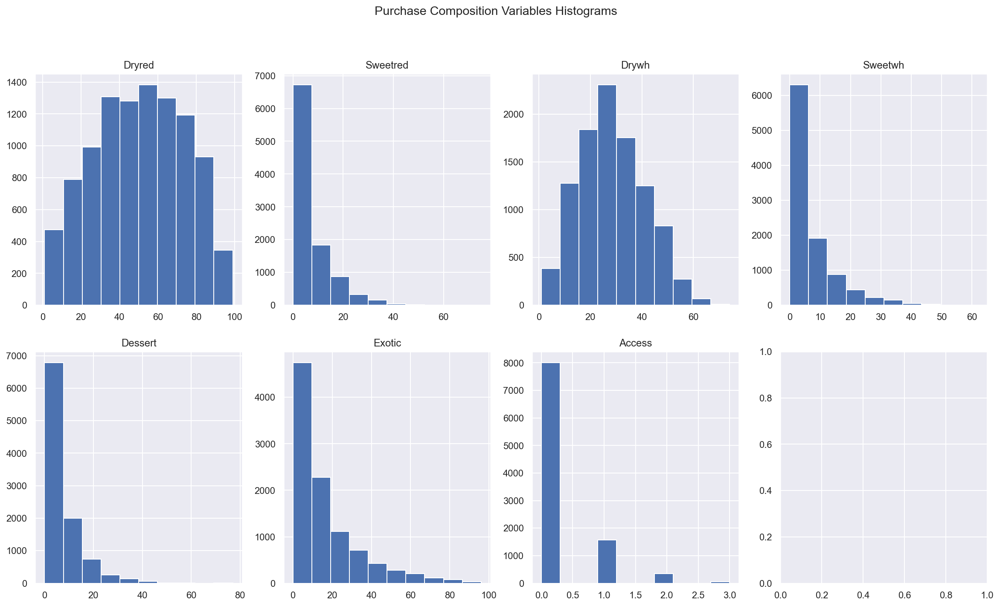

In [25]:
plot_multiple_histograms(data_integrity_dataset, purchase_composition, 'Purchase Composition Variables Histograms')

We observe that the records with auxiliary variable total_wine not equal to 100 either sum 99 or 101.

We also check that variable Dryred is the one more close of being a "uniform" distribution.

We decide to adjust variable Dryred summing +1 or -1 depending if the sum is 99 or 101, respectively.

In [26]:
data_integrity_dataset.loc[data_integrity_dataset["total_wine"] == 99, "Dryred"] = data_integrity_dataset["Dryred"] +1
data_integrity_dataset.loc[data_integrity_dataset["total_wine"] == 101, "Dryred"] = data_integrity_dataset["Dryred"] -1

We update both datasets

In [27]:
clientprofile_dataset = data_integrity_dataset[clientprofile_variables]
buyingbehaviour_dataset = data_integrity_dataset[buyingbehaviour_variables]

## 2.2 Data's First Statistics and Data Visualization
In this chapter, the group initiates his data analysis

In [28]:
#Following the same safety procedures, we create a backup for both segmentation datasets -> Recency is on both of them
clientprofile_initial_dataset_backup2 = clientprofile_dataset
buyingbehaviour_initial_dataset_backup2 = buyingbehaviour_dataset

clientprofile_variables_backup2 = clientprofile_variables
buyingbehaviour_variables_backup2 = buyingbehaviour_variables

In [29]:
#reset step
#clientprofile_dataset = clientprofile_initial_dataset_backup2
#buyingbehaviour_dataset = buyingbehaviour_initial_dataset_backup2

#clientprofile_variables = clientprofile_variables_backup2
#buyingbehaviour_variables = buyingbehaviour_variables_backup2

In [30]:
#brief statistics of the Client Profile dataset
clientprofile_dataset.describe(include="all").T

,count,mean,std,min,25%,50%,75%,max
Age,10000.0,47.927300,17.302721,18.0,33.00,48.00,63.00,78.0
Educ,10000.0,16.739100,1.876375,12.0,15.00,17.00,18.00,20.0
Income,10000.0,69904.358000,27612.233311,10000.0,47642.00,70012.00,92147.00,140628.0
Kidhome,10000.0,0.418800,0.493387,0.0,0.00,0.00,1.00,1.0
Teenhome,10000.0,0.469800,0.499112,0.0,0.00,0.00,1.00,1.0
Dayswus,10000.0,898.102000,202.492789,550.0,723.75,894.00,1074.00,1250.0
Freq,10000.0,14.628100,11.969073,1.0,4.00,12.00,24.00,56.0
Recency,10000.0,62.406800,69.874255,0.0,26.00,52.00,78.25,549.0
Monetary,10000.0,622.555200,647.135323,6.0,63.00,383.00,1077.00,3052.0
AVRPUR,10000.0,31.942299,13.711039,6.0,20.00,31.92,44.88,54.5


In [31]:
#brief statistics of the Buying Behaviour dataset
buyingbehaviour_dataset.describe(include="all").T

,count,mean,std,min,25%,50%,75%,max
Age,10000.0,47.9273,17.302721,18.0,33.0,48.0,63.0,78.0
Educ,10000.0,16.7391,1.876375,12.0,15.0,17.0,18.0,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.0,70012.0,92147.0,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.0,0.0,1.0,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.0,0.0,1.0,1.0
Dryred,10000.0,50.4070,23.480445,1.0,32.0,51.0,69.0,99.0
Sweetred,10000.0,7.0545,7.866544,0.0,2.0,4.0,10.0,75.0
Drywh,10000.0,28.5213,12.583957,1.0,19.0,28.0,37.0,74.0
Sweetwh,10000.0,7.0698,8.015083,0.0,2.0,4.0,10.0,62.0
Dessert,10000.0,6.9474,7.879546,0.0,2.0,4.0,9.0,77.0


In [32]:
categoric_var = ['Kidhome','Teenhome']
metric_var_cp = [var for var in clientprofile_initial_variables if var not in categoric_var]

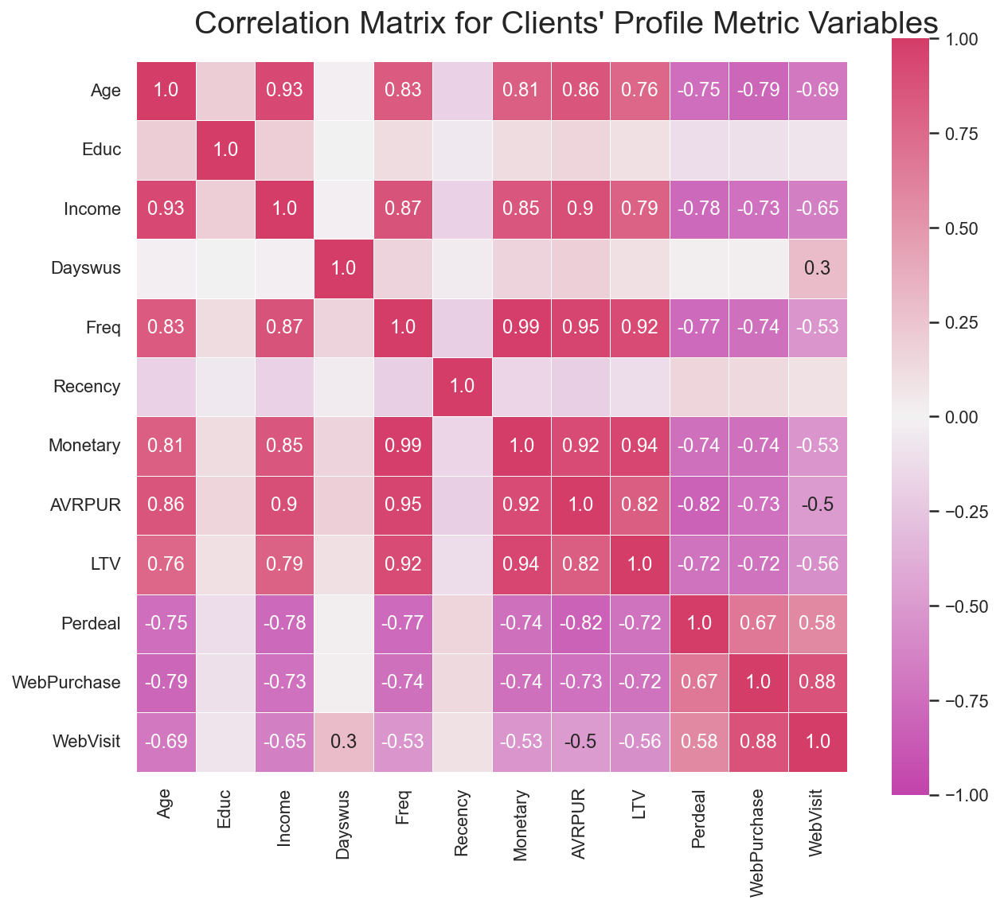

In [33]:
#ploting Pearson's Correlation Matrix for metric variables within the most updated Client Profile dataset
fig = plt.figure(figsize=(10, 8))

corr = np.round(clientprofile_dataset[metric_var_cp].corr(method="pearson"), decimals=2)

mask_annot = np.absolute(corr.values) >= 0.3
annot = np.where(mask_annot, corr.values, np.full(corr.shape,""))

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(320, 360, as_cmap=True), 
fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=0.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix for Clients' Profile Metric Variables", fontsize=20)

plt.show()

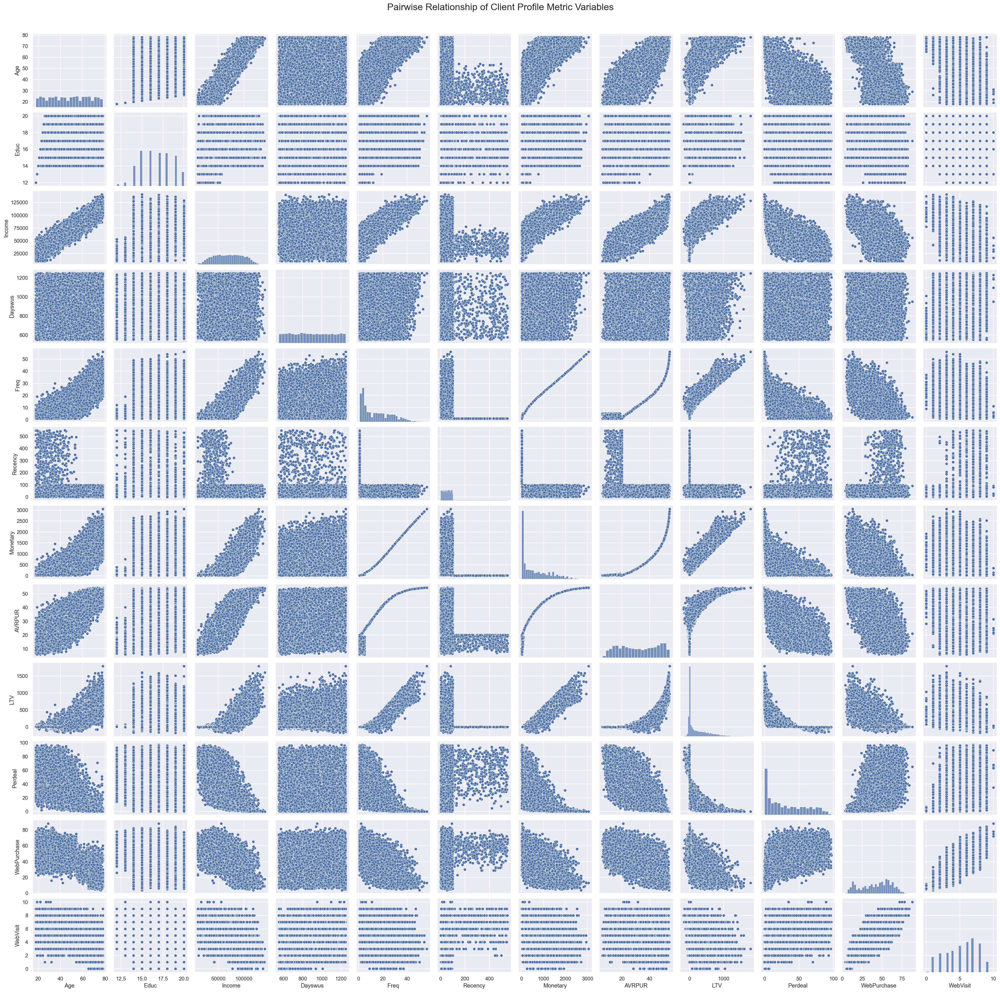

In [34]:
# Pairwise Relationship of All metric Variables
sns.set()

# Setting pairplot
sns.pairplot(clientprofile_dataset[metric_var_cp], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Client Profile Metric Variables", fontsize=20)

plt.show()

<AxesSubplot:xlabel='Kidhome', ylabel='WebVisit'>

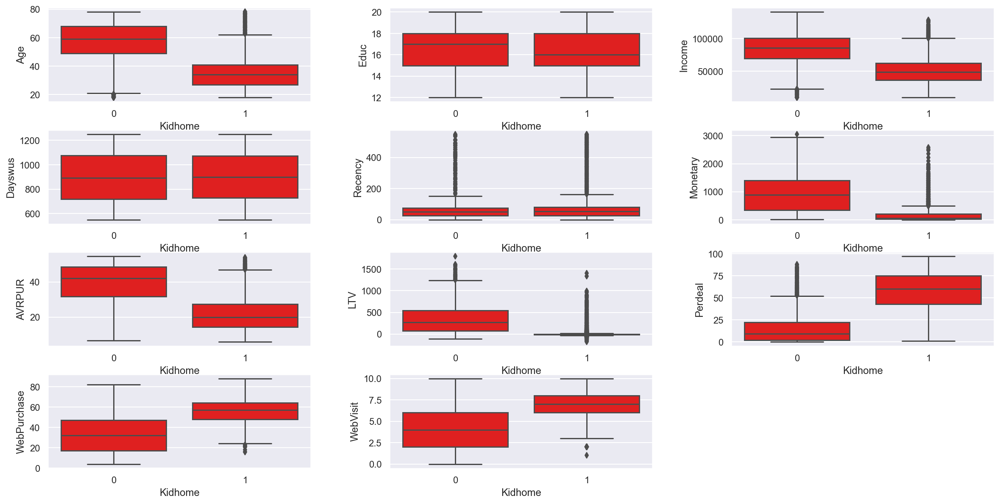

In [35]:
fig = plt.figure(figsize=(2,3))
fig.set_size_inches(20,10)
fig.subplots_adjust(hspace=0.3, wspace=0.3)

gs = fig.add_gridspec(nrows=4,ncols=3)
ax1 = fig.add_subplot(gs[0,0])
ax2 = fig.add_subplot(gs[0,1])
ax3 = fig.add_subplot(gs[0,2])
ax4 = fig.add_subplot(gs[1,0])
ax5 = fig.add_subplot(gs[1,1])
ax6 = fig.add_subplot(gs[1,2])
ax7 = fig.add_subplot(gs[2,0])
ax8 = fig.add_subplot(gs[2,1])
ax9 = fig.add_subplot(gs[2,2])
ax10 = fig.add_subplot(gs[3,0])
ax11 = fig.add_subplot(gs[3,1])

sns.boxplot(x="Kidhome", y="Age", data=clientprofile_dataset, ax=ax1, color='red')
sns.boxplot(x="Kidhome", y="Educ", data=clientprofile_dataset, ax=ax2, color='red')
sns.boxplot(x="Kidhome", y="Income", data=clientprofile_dataset, ax=ax3, color='red')
sns.boxplot(x="Kidhome", y="Dayswus", data=clientprofile_dataset, ax=ax4, color='red')
sns.boxplot(x="Kidhome", y="Recency", data=clientprofile_dataset, ax=ax5, color='red')
sns.boxplot(x="Kidhome", y="Monetary", data=clientprofile_dataset, ax=ax6, color='red')
sns.boxplot(x="Kidhome", y="AVRPUR", data=clientprofile_dataset, ax=ax7, color='red')
sns.boxplot(x="Kidhome", y="LTV", data=clientprofile_dataset, ax=ax8, color='red')
sns.boxplot(x="Kidhome", y="Perdeal", data=clientprofile_dataset, ax=ax9, color='red')
sns.boxplot(x="Kidhome", y="WebPurchase", data=clientprofile_dataset, ax=ax10, color='red')
sns.boxplot(x="Kidhome", y="WebVisit", data=clientprofile_dataset, ax=ax11, color='red')

<AxesSubplot:xlabel='Teenhome', ylabel='WebVisit'>

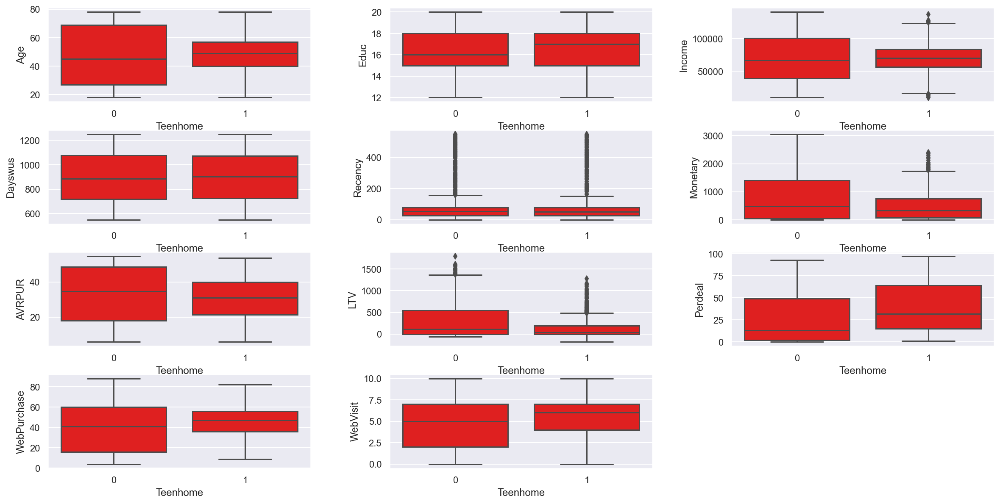

In [36]:
fig = plt.figure(figsize=(2,3))
fig.set_size_inches(20,10)
fig.subplots_adjust(hspace=0.3, wspace=0.3)

gs = fig.add_gridspec(nrows=4,ncols=3)
ax1 = fig.add_subplot(gs[0,0])
ax2 = fig.add_subplot(gs[0,1])
ax3 = fig.add_subplot(gs[0,2])
ax4 = fig.add_subplot(gs[1,0])
ax5 = fig.add_subplot(gs[1,1])
ax6 = fig.add_subplot(gs[1,2])
ax7 = fig.add_subplot(gs[2,0])
ax8 = fig.add_subplot(gs[2,1])
ax9 = fig.add_subplot(gs[2,2])
ax10 = fig.add_subplot(gs[3,0])
ax11 = fig.add_subplot(gs[3,1])

sns.boxplot(x="Teenhome", y="Age", data=clientprofile_dataset, ax=ax1, color='red')
sns.boxplot(x="Teenhome", y="Educ", data=clientprofile_dataset, ax=ax2, color='red')
sns.boxplot(x="Teenhome", y="Income", data=clientprofile_dataset, ax=ax3, color='red')
sns.boxplot(x="Teenhome", y="Dayswus", data=clientprofile_dataset, ax=ax4, color='red')
sns.boxplot(x="Teenhome", y="Recency", data=clientprofile_dataset, ax=ax5, color='red')
sns.boxplot(x="Teenhome", y="Monetary", data=clientprofile_dataset, ax=ax6, color='red')
sns.boxplot(x="Teenhome", y="AVRPUR", data=clientprofile_dataset, ax=ax7, color='red')
sns.boxplot(x="Teenhome", y="LTV", data=clientprofile_dataset, ax=ax8, color='red')
sns.boxplot(x="Teenhome", y="Perdeal", data=clientprofile_dataset, ax=ax9, color='red')
sns.boxplot(x="Teenhome", y="WebPurchase", data=clientprofile_dataset, ax=ax10, color='red')
sns.boxplot(x="Teenhome", y="WebVisit", data=clientprofile_dataset, ax=ax11, color='red')

We instantly observe that variables Educ, Teenhome, Dayswus and Recency don't have a strong correlation with the other ones.

**We also decide to drop variables Freq and Monetary, since the new variable AVRPUR is heavy correlated with them and has a greater correlation to the other variables.**

We are dropping them from Client's Profile dataset.

In [37]:
#removing variables
clientprofile_dataset = clientprofile_dataset.drop(columns=['Educ','Teenhome','Dayswus','Recency','Freq','Monetary'])

#updating clientprofile variables list
remove = ['Educ','Teenhome','Dayswus','Recency','Freq','Monetary']
clientprofile_variables = [var for var in clientprofile_initial_variables if var not in remove]
metric_var_cp = [var for var in metric_var_cp if var not in remove]

In [38]:
metric_var_bb = [var for var in buyingbehaviour_initial_variables if var not in categoric_var]

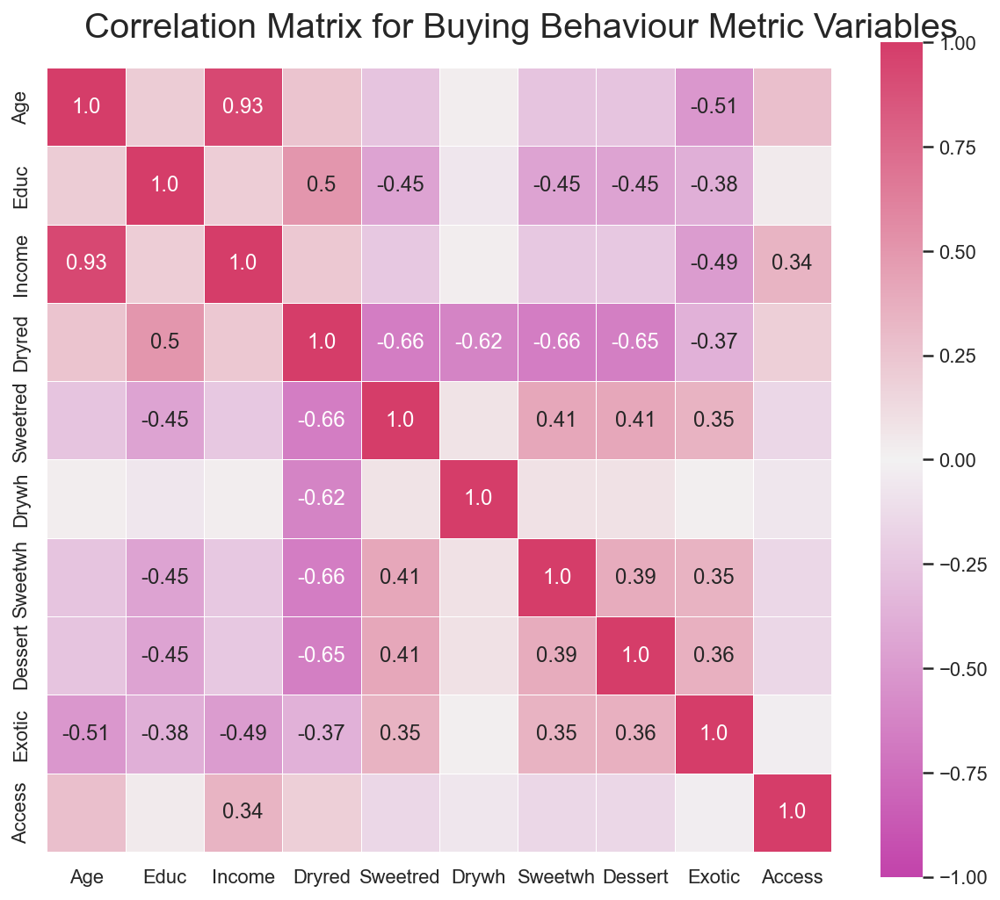

In [39]:
#ploting Pearson's Correlation Matrix for metric variables within the most updated Buying Behaviour dataset
fig = plt.figure(figsize=(10, 8))

corr = np.round(buyingbehaviour_dataset[metric_var_bb].corr(method="pearson"), decimals=2)

mask_annot = np.absolute(corr.values) >= 0.3
annot = np.where(mask_annot, corr.values, np.full(corr.shape,""))

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(320, 360, as_cmap=True), 
fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=0.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix for Buying Behaviour Metric Variables", fontsize=20)

plt.show()

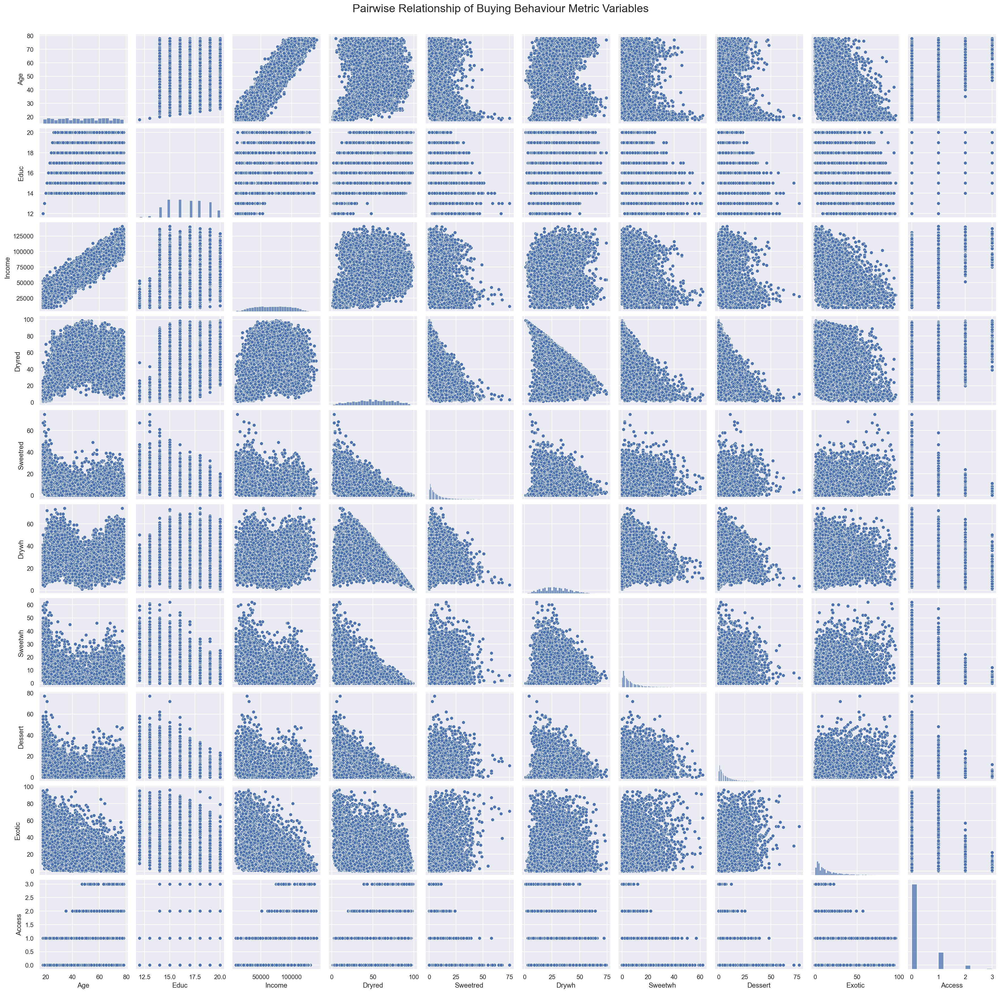

In [40]:
# Pairwise Relationship of All metric Variables
sns.set()

# Setting pairplot
sns.pairplot(buyingbehaviour_dataset[metric_var_bb], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Buying Behaviour Metric Variables", fontsize=20)

plt.show()

<AxesSubplot:xlabel='Kidhome', ylabel='Access'>

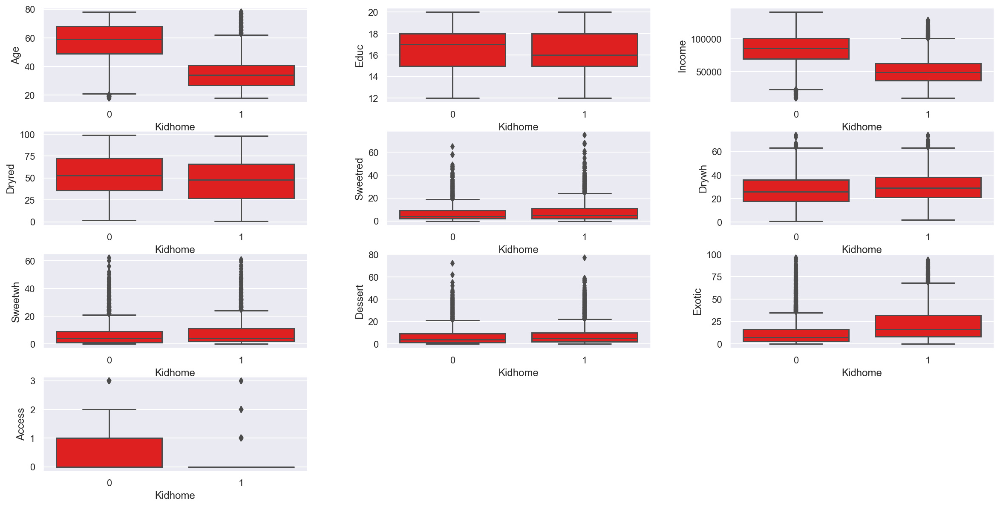

In [41]:
fig = plt.figure(figsize=(2,3))
fig.set_size_inches(20,10)
fig.subplots_adjust(hspace=0.3, wspace=0.3)

gs = fig.add_gridspec(nrows=4,ncols=3)
ax1 = fig.add_subplot(gs[0,0])
ax2 = fig.add_subplot(gs[0,1])
ax3 = fig.add_subplot(gs[0,2])
ax4 = fig.add_subplot(gs[1,0])
ax5 = fig.add_subplot(gs[1,1])
ax6 = fig.add_subplot(gs[1,2])
ax7 = fig.add_subplot(gs[2,0])
ax8 = fig.add_subplot(gs[2,1])
ax9 = fig.add_subplot(gs[2,2])
ax10 = fig.add_subplot(gs[3,0])

sns.boxplot(x="Kidhome", y="Age", data=buyingbehaviour_dataset, ax=ax1, color='red')
sns.boxplot(x="Kidhome", y="Educ", data=buyingbehaviour_dataset, ax=ax2, color='red')
sns.boxplot(x="Kidhome", y="Income", data=buyingbehaviour_dataset, ax=ax3, color='red')
sns.boxplot(x="Kidhome", y="Dryred", data=buyingbehaviour_dataset, ax=ax4, color='red')
sns.boxplot(x="Kidhome", y="Sweetred", data=buyingbehaviour_dataset, ax=ax5, color='red')
sns.boxplot(x="Kidhome", y="Drywh", data=buyingbehaviour_dataset, ax=ax6, color='red')
sns.boxplot(x="Kidhome", y="Sweetwh", data=buyingbehaviour_dataset, ax=ax7, color='red')
sns.boxplot(x="Kidhome", y="Dessert", data=buyingbehaviour_dataset, ax=ax8, color='red')
sns.boxplot(x="Kidhome", y="Exotic", data=buyingbehaviour_dataset, ax=ax9, color='red')
sns.boxplot(x="Kidhome", y="Access", data=buyingbehaviour_dataset, ax=ax10, color='red')

<AxesSubplot:xlabel='Teenhome', ylabel='Access'>

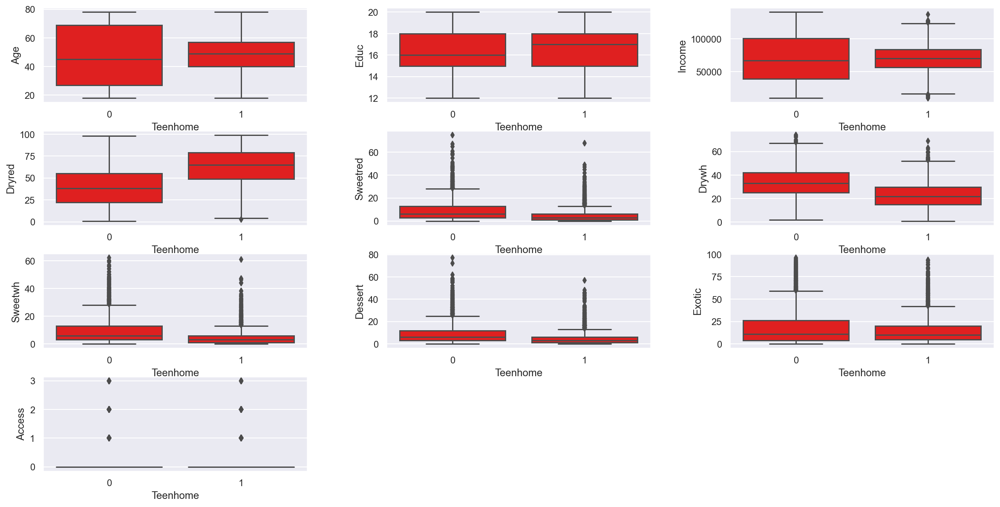

In [42]:
fig = plt.figure(figsize=(2,3))
fig.set_size_inches(20,10)
fig.subplots_adjust(hspace=0.3, wspace=0.3)

gs = fig.add_gridspec(nrows=4,ncols=3)
ax1 = fig.add_subplot(gs[0,0])
ax2 = fig.add_subplot(gs[0,1])
ax3 = fig.add_subplot(gs[0,2])
ax4 = fig.add_subplot(gs[1,0])
ax5 = fig.add_subplot(gs[1,1])
ax6 = fig.add_subplot(gs[1,2])
ax7 = fig.add_subplot(gs[2,0])
ax8 = fig.add_subplot(gs[2,1])
ax9 = fig.add_subplot(gs[2,2])
ax10 = fig.add_subplot(gs[3,0])

sns.boxplot(x="Teenhome", y="Age", data=buyingbehaviour_dataset, ax=ax1, color='red')
sns.boxplot(x="Teenhome", y="Educ", data=buyingbehaviour_dataset, ax=ax2, color='red')
sns.boxplot(x="Teenhome", y="Income", data=buyingbehaviour_dataset, ax=ax3, color='red')
sns.boxplot(x="Teenhome", y="Dryred", data=buyingbehaviour_dataset, ax=ax4, color='red')
sns.boxplot(x="Teenhome", y="Sweetred", data=buyingbehaviour_dataset, ax=ax5, color='red')
sns.boxplot(x="Teenhome", y="Drywh", data=buyingbehaviour_dataset, ax=ax6, color='red')
sns.boxplot(x="Teenhome", y="Sweetwh", data=buyingbehaviour_dataset, ax=ax7, color='red')
sns.boxplot(x="Teenhome", y="Dessert", data=buyingbehaviour_dataset, ax=ax8, color='red')
sns.boxplot(x="Teenhome", y="Exotic", data=buyingbehaviour_dataset, ax=ax9, color='red')
sns.boxplot(x="Teenhome", y="Access", data=buyingbehaviour_dataset, ax=ax10, color='red')

It appears we have chose well our dataset variables
* [Choice Options (Ref)](#choiceBBaproach) </font> <a class="anchor" id="choiceBBtaken"></a>

**We decide to drop variables Income, Kidhome and Access**

We have a lot of variables and these aren't as correlated/ don't have so much impact as the others.

By removing them we hope to avoid some troubles concerneaning to excessive data labels (curse of dimensionality).

In [43]:
#removing variables
buyingbehaviour_dataset = buyingbehaviour_dataset.drop(columns=['Income','Kidhome','Access'])

#updating clientprofile variables list
remove = ['Income','Kidhome','Access']
buyingbehaviour_variables = [var for var in buyingbehaviour_initial_variables if var not in remove]
metric_var_bb = [var for var in metric_var_bb if var not in remove]

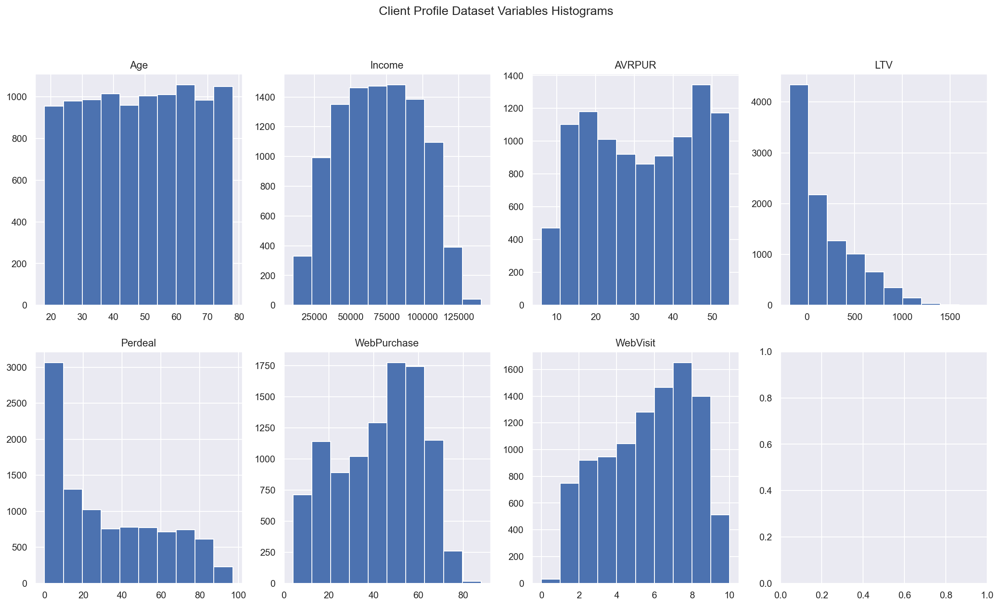

In [44]:
#ploting histograms for variables within the most updated Client Profile dataset
plot_multiple_histograms(clientprofile_dataset, metric_var_cp, 'Client Profile Dataset Variables Histograms')

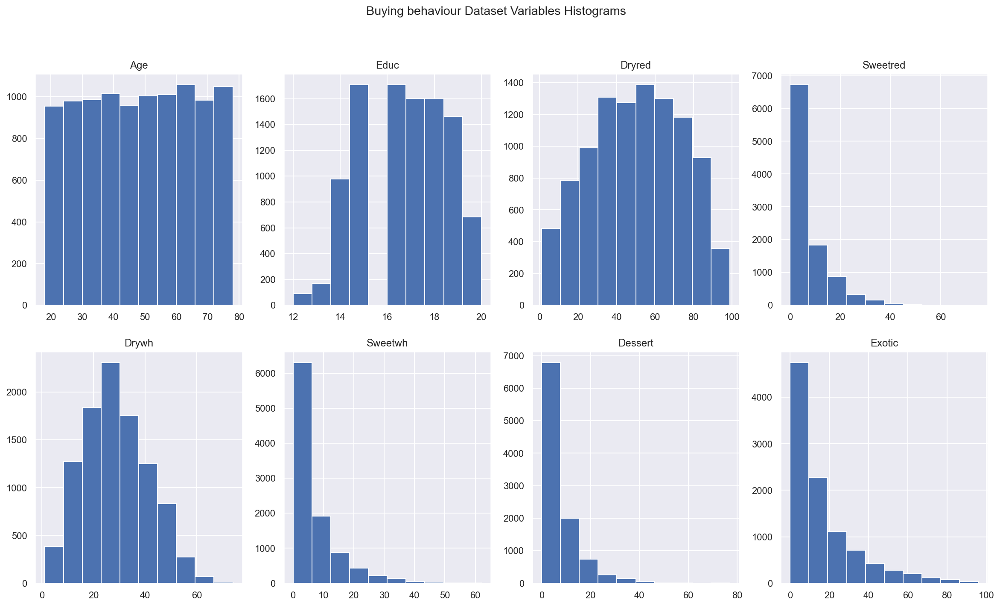

In [45]:
#ploting histograms for variables within the most updated Buying Behaviour dataset
plot_multiple_histograms(buyingbehaviour_dataset, metric_var_bb, 'Buying behaviour Dataset Variables Histograms')

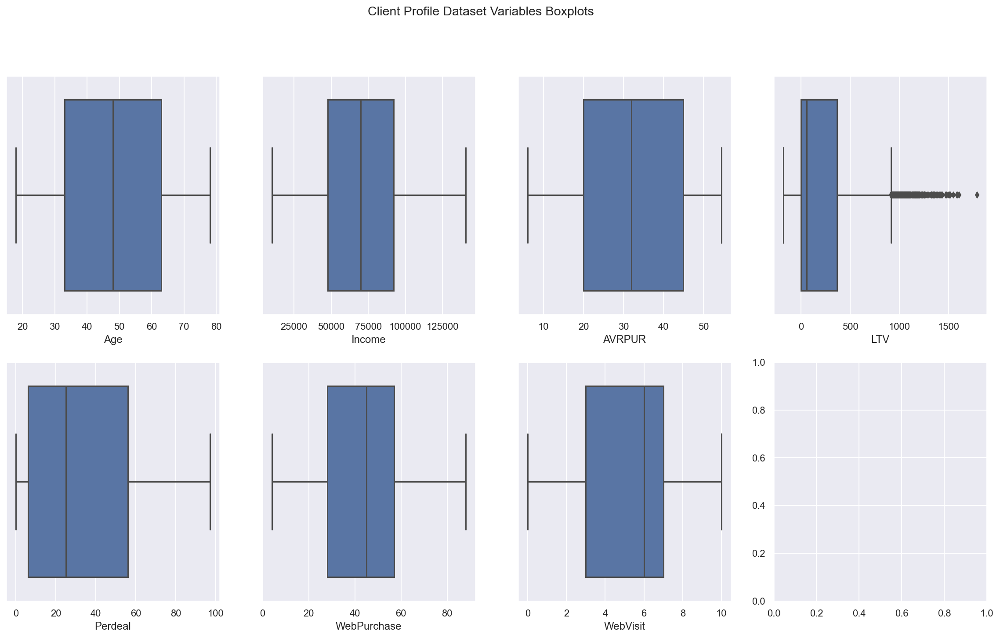

In [46]:
#ploting boxplots for variables within the most updated Client Profile dataset
plot_multiple_boxplots(clientprofile_dataset, metric_var_cp, 'Client Profile Dataset Variables Boxplots')

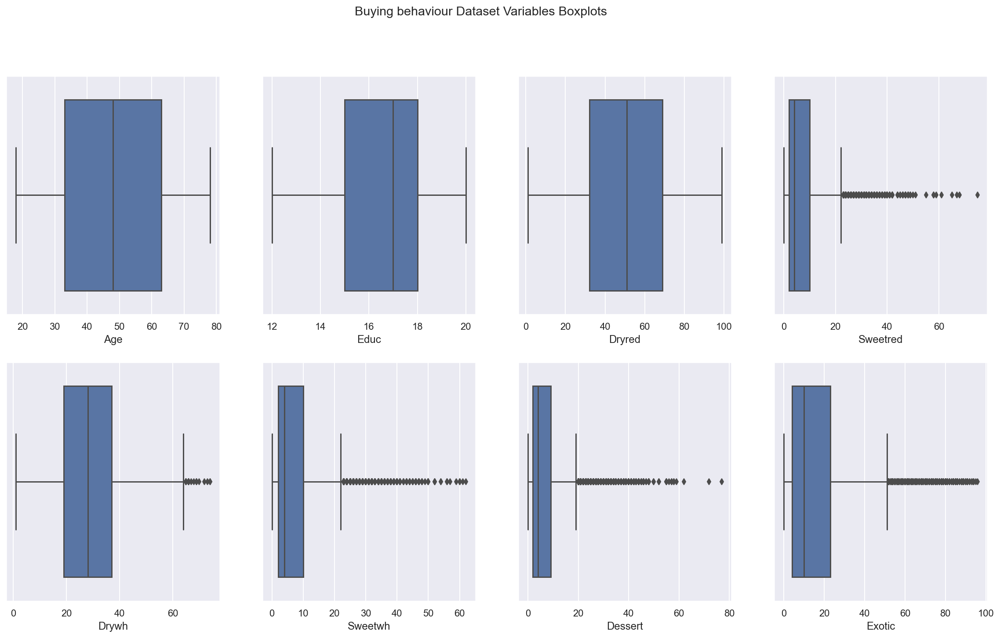

In [47]:
#ploting boxplots for variables within the most updated Buying Behaviour dataset
plot_multiple_boxplots(buyingbehaviour_dataset, metric_var_bb, 'Buying behaviour Dataset Variables Boxplots')

# <font color='#5E2190'>3. Data Pre-Processing </font> <a class="anchor" id="Proccesing"></a>
**Datasets' Treatment**

[To Index](#toc) 

## 3.1 Outliers' Removal and attenuation of Imbalaced Variables' complication
**Problematic records removal...**

By looking at the assembled statistics and graphics we find some record with variables' values that could create some problems in the clustering process

In [48]:
#counter0
counter = 0

In [49]:
#auxiliary
combined_dataset = data_integrity_dataset.drop(['total_wine'], axis=1)

**We also take time to distinguish between metric and non-metric variables.**

In [50]:
#update variables
clientprofile_variables_metric = metric_var_cp
buyingbehaviour_variables_metric = metric_var_bb

### 3.1.1 Client's Profile

In [51]:
#backup for safety programmation measures
clientprofile_dataset_backup3 = clientprofile_dataset.copy()
clientprofile_variables_backup3 = clientprofile_variables.copy()

#counter especifically for client's profile dataset
counter_clientprofile = counter

In [52]:
# reset step
#clientprofile_dataset = clientprofile_dataset_backup3
#clientprofile_variables =  clientprofile_variables_backup3

**We take again some time to check the variables' distributions and skewness.**

We hope that by doing this we will be able to detect some "problems" with the data that might affect the quality of the future Clients' Profile segmentation.

Text(0.5, 0.98, 'Histplots for outliers detection')

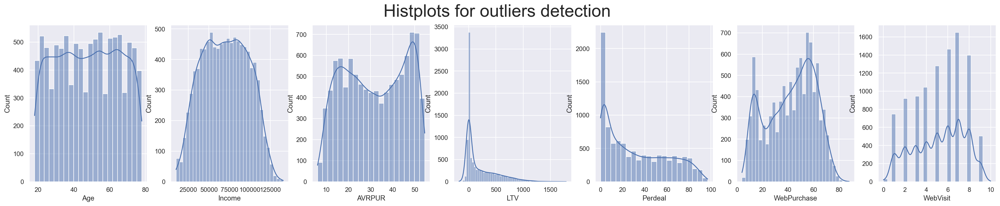

In [53]:
plt.figure(figsize = (30, 5))
for i in enumerate(clientprofile_variables_metric):
    plt.subplot(1, 7,i[0]+1)
    sns.histplot(x=i[1], data=clientprofile_dataset,kde=True)
plt.suptitle("Histplots for outliers detection", fontsize=30)

In [54]:
clientprofile_dataset.skew()

Age           -0.010356
Income         0.005863
Kidhome        0.329219
AVRPUR        -0.048323
LTV            1.446741
Perdeal        0.519227
WebPurchase   -0.263583
WebVisit      -0.278645
dtype: float64

In [55]:
clientprofile_dataset.skew().mean()

0.2125179197297326

In [56]:
clientprofile_dataset.kurtosis()

Age           -1.197101
Income        -0.924811
Kidhome       -1.891993
AVRPUR        -1.328300
LTV            1.540461
Perdeal       -1.054212
WebPurchase   -1.038021
WebVisit      -0.993668
dtype: float64

In [57]:
clientprofile_dataset.kurtosis().mean()

-0.8609554186052635

In [58]:
clientprofile_dataset['LTV'].describe()

count    10000.00000
mean       209.07120
std        291.98604
min       -178.00000
25%         -2.00000
50%         57.00000
75%        364.00000
max       1791.00000
Name: LTV, dtype: float64

We can observe that most of the variables are well-behaved, with a low skeweness and not dispersing too much from the mean (highest |kurtosis| value is only close to 2).

However, as seen previously, some records have values for variable LTV outside the barriers.

We also notice this variable is higly positive skewed.

This leads us to immediate think of ways to attenuate the emerging complications this "problematic" variable could bring.

We must remember that, as there are records with negative values, we can't afford to apply a Logarithmic transformation to LTV variable.

**We start to look at data's percentage after removing each of these problematic values through the IQR method.**

In [59]:
# % after removing LTV variable LTV outliers by IQR method
Q1_LTV = clientprofile_dataset['LTV'].quantile(0.25)
Q3_LTV = clientprofile_dataset['LTV'].quantile(0.75) 
IQR_LTV = Q3_LTV - Q1_LTV
counter_IQR_LTV = counter_clientprofile + ((clientprofile_dataset['LTV']<=(Q1_LTV-1.5*(IQR_LTV))).sum()) + ((clientprofile_dataset['LTV']>=(Q3_LTV+1.5*(IQR_LTV))).sum())
data_percentagekept(counter_IQR_LTV)

Percentage of data kept after removing outliers: 96.77


As we still intent to remove variables based on density criterias, we can't afford to already drop such a data amount.

**We remove LTV outliers manually so we have a greater % of data retained.**

Also, later, with the normalization we'll also deal with this thematic.

In [60]:
#we are plotting the histogram with the ammount of bins defined by Sturges rule
n = 10000
sturges_bins = int(mat.log(n,2)+1)
sturges_bins

14

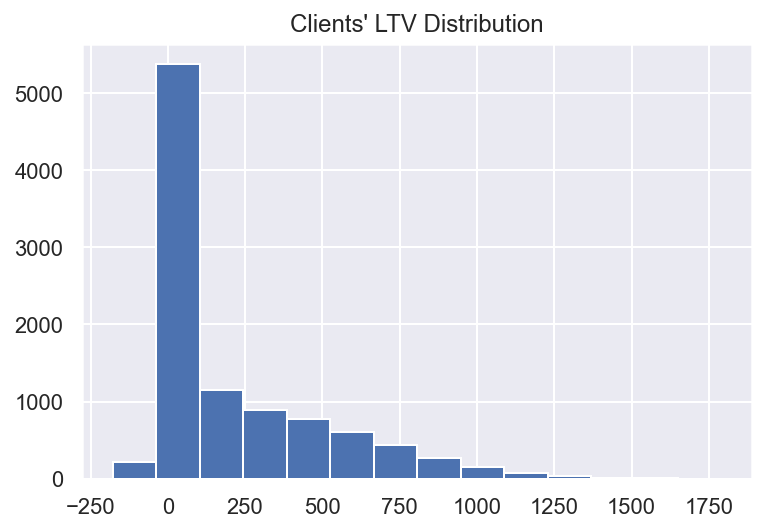

In [61]:
#plotting the histogram for LTV variable
plt.hist(clientprofile_dataset["LTV"], bins=sturges_bins)
plt.title("Clients' LTV Distribution")
plt.show()

Text(0.5, 1.0, 'Box Plot of LTV Variable')

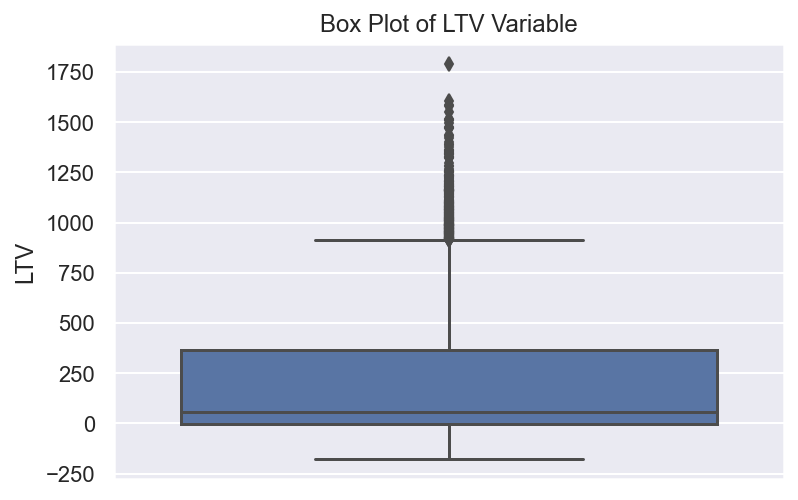

In [62]:
#plotting the boxplot for LTV variable
sns.boxplot(y=clientprofile_dataset["LTV"])
plt.title("Box Plot of LTV Variable")

We can observe that the dataset has a considerable amount of WWW's clients with a LTV above the superior hurdle.

For that reason we can't drop all this records as we were going to disregard a very important clients' niche: the most valuable clients.

**We check on the possibility of dropping clients with a LTV superior to 1000.**

In [63]:
#counter_manual_LTV = (combined_dataset['LTV']>1000).sum()
counter_manual_LTV = (combined_dataset['LTV']>1000).sum()
data_percentagekept(counter_manual_LTV)

Percentage of data kept after removing outliers: 97.99


**We agree on this possibility.**

In [64]:
#saving outliers
outliers_dataset = combined_dataset[combined_dataset['LTV']>(1000)]
                                         
#dropping records
combined_dataset = combined_dataset[combined_dataset['LTV']<=(1000)]
clientprofile_dataset = combined_dataset[clientprofile_variables]
buyingbehaviour_dataset = combined_dataset[buyingbehaviour_variables]

Text(0.5, 0.98, 'Histplots after outliers removement')

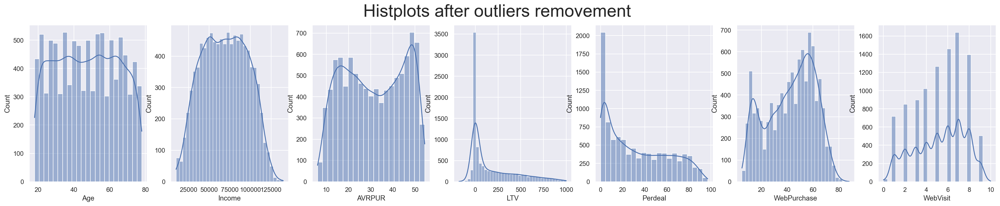

In [65]:
plt.figure(figsize = (30, 5))
for i in enumerate(clientprofile_variables_metric):
    plt.subplot(1, 7,i[0]+1)
    sns.histplot(x=i[1], data=clientprofile_dataset,kde=True)
plt.suptitle("Histplots after outliers removement", fontsize=30)

### 3.1.2 Buying Behaviour

In [66]:
#backup for safety programmation measures
buyingbehaviour_dataset_backup3 = buyingbehaviour_dataset.copy()
buyingbehaviour_variables_backup3 = buyingbehaviour_variables.copy()

#counter especifically for client's profile dataset
counter_buyingbehaviour = counter

In [67]:
#step reset
#buyingbehaviour_dataset = clientprofile_dataset_backup3
#buyingbehaviour_variables = buyingbehaviour_variables_backup3

Text(0.5, 0.98, 'Histplots for outliers detection')

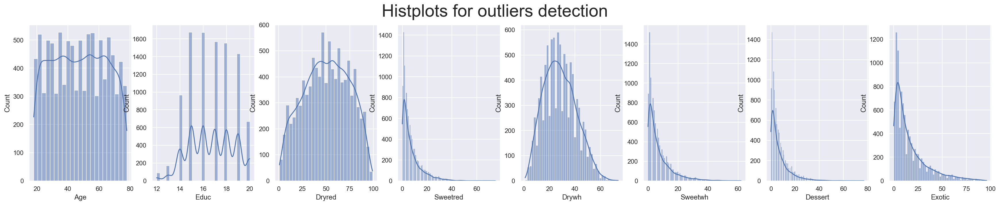

In [68]:
plt.figure(figsize = (30, 5))
for i in enumerate(buyingbehaviour_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=buyingbehaviour_dataset,kde=True)
plt.suptitle("Histplots for outliers detection", fontsize=30)

Text(0.5, 0.98, 'Boxplot')

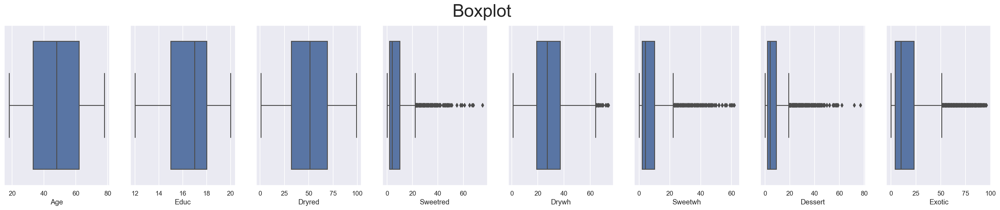

In [69]:
plt.figure(figsize = (30, 5))
for i in enumerate(buyingbehaviour_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.boxplot(x = i[1], data = buyingbehaviour_dataset)
plt.suptitle("Boxplot", fontsize=30)

In [70]:
buyingbehaviour_dataset.skew()

Age         0.011286
Educ       -0.063933
Teenhome    0.086429
Dryred     -0.082004
Sweetred    2.055821
Drywh       0.330013
Sweetwh     2.096393
Dessert     2.196529
Exotic      1.692376
dtype: float64

In [71]:
buyingbehaviour_dataset.skew().mean()

0.9247678003529862

In [72]:
buyingbehaviour_dataset.kurtosis()

Age        -1.178285
Educ       -0.830369
Teenhome   -1.992937
Dryred     -0.934066
Sweetred    5.722894
Drywh      -0.422658
Sweetwh     5.583728
Dessert     6.591482
Exotic      2.750342
dtype: float64

In [73]:
buyingbehaviour_dataset['Sweetred'].describe()

count    9799.000000
mean        7.077967
std         7.907098
min         0.000000
25%         2.000000
50%         4.000000
75%        10.000000
max        75.000000
Name: Sweetred, dtype: float64

In [74]:
buyingbehaviour_dataset['Drywh'].describe()

count    9799.000000
mean       28.361670
std        12.558661
min         1.000000
25%        19.000000
50%        27.000000
75%        37.000000
max        74.000000
Name: Drywh, dtype: float64

In [75]:
buyingbehaviour_dataset['Sweetwh'].describe()

count    9799.000000
mean        7.103684
std         8.062983
min         0.000000
25%         2.000000
50%         4.000000
75%        10.000000
max        62.000000
Name: Sweetwh, dtype: float64

In [76]:
buyingbehaviour_dataset['Dessert'].describe()

count    9799.000000
mean        6.967650
std         7.928973
min         0.000000
25%         2.000000
50%         4.000000
75%         9.000000
max        77.000000
Name: Dessert, dtype: float64

In [77]:
buyingbehaviour_dataset['Exotic'].describe()

count    9799.000000
mean       16.774671
std        17.325576
min         0.000000
25%         4.000000
50%        10.000000
75%        23.000000
max        96.000000
Name: Exotic, dtype: float64

As seen before, some records have values for variables Sweetred, Drywh, Sweetwh, Dessert and Exotic, outside the barriers in the boxplot.

After studying these variables skeweness and kurtosis, we are sure we must at least try to scarce their "wild behaviour" to the maximum within our possibilities.

If we don't do it, we'll have to deal with the problems that these multiple variables might bring to the segmentation building.

**We start to look at data's percentage after removing each of the values through IQR method.**

**Then at the % after combined variables' IQR method is applied.**

In [78]:
# % after removing Sweetred variable outliers by IQR method
Q1_Sweetred = buyingbehaviour_dataset['Sweetred'].quantile(0.25)
Q3_Sweetred = buyingbehaviour_dataset['Sweetred'].quantile(0.75) 
IQR_Sweetred = Q3_Sweetred - Q1_Sweetred
counter_IQR_Sweetred = counter_buyingbehaviour + ((buyingbehaviour_dataset['Sweetred']<=(Q1_Sweetred-1.5*(IQR_Sweetred))).sum()) + ((buyingbehaviour_dataset['Sweetred']>=(Q3_Sweetred+1.5*(IQR_Sweetred))).sum())
data_percentagekept(counter_IQR_Sweetred)

Percentage of data kept after removing outliers: 93.67


In [79]:
# % after removing Drywh variable outliers by IQR method
Q1_Drywh = buyingbehaviour_dataset['Drywh'].quantile(0.25)
Q3_Drywh = buyingbehaviour_dataset['Drywh'].quantile(0.75) 
IQR_Drywh = Q3_Drywh - Q1_Drywh
counter_IQR_Drywh = counter_buyingbehaviour + ((buyingbehaviour_dataset['Drywh']<=(Q1_Drywh-1.5*(IQR_Drywh))).sum()) + ((buyingbehaviour_dataset['Drywh']>=(Q3_Drywh+1.5*(IQR_Drywh))).sum())
data_percentagekept(counter_IQR_Drywh)

Percentage of data kept after removing outliers: 99.7


In [80]:
# % after removing Sweetwh variable outliers by IQR method
Q1_Sweetwh = buyingbehaviour_dataset['Sweetwh'].quantile(0.25)
Q3_Sweetwh = buyingbehaviour_dataset['Sweetwh'].quantile(0.75) 
IQR_Sweetwh = Q3_Sweetwh - Q1_Sweetwh
counter_IQR_Sweetwh = counter_buyingbehaviour + ((buyingbehaviour_dataset['Sweetwh']<=(Q1_Sweetwh-1.5*(IQR_Sweetwh))).sum()) + ((buyingbehaviour_dataset['Sweetwh']>=(Q3_Sweetwh+1.5*(IQR_Sweetwh))).sum())
data_percentagekept(counter_IQR_Sweetwh)

Percentage of data kept after removing outliers: 93.67


In [81]:
# % after removing Dessert variable Dessert outliers by IQR method
Q1_Dessert = buyingbehaviour_dataset['Dessert'].quantile(0.25)
Q3_Dessert = buyingbehaviour_dataset['Dessert'].quantile(0.75) 
IQR_Dessert = Q3_Sweetred - Q1_Dessert
counter_IQR_Dessert = counter_buyingbehaviour + ((buyingbehaviour_dataset['Dessert']<=(Q1_Dessert-1.5*(IQR_Dessert))).sum()) + ((buyingbehaviour_dataset['Dessert']>=(Q3_Dessert+1.5*(IQR_Dessert))).sum())
data_percentagekept(counter_IQR_Dessert)

Percentage of data kept after removing outliers: 93.4


In [82]:
# % after removing Exotic variable outliers by IQR method
Q1_Exotic = buyingbehaviour_dataset['Exotic'].quantile(0.25)
Q3_Exotic = buyingbehaviour_dataset['Exotic'].quantile(0.75) 
IQR_Exotic = Q3_Exotic - Q1_Exotic
counter_IQR_Exotic = counter_buyingbehaviour + ((buyingbehaviour_dataset['Exotic']<=(Q1_Sweetred-1.5*(IQR_Exotic))).sum()) + ((buyingbehaviour_dataset['Exotic']>=(Q3_Exotic+1.5*(IQR_Exotic))).sum())
data_percentagekept(counter_IQR_Exotic)

Percentage of data kept after removing outliers: 94.11


In [83]:
# min % of data kept after combined variables' IQR  outliers
counter_IQR_combined_buyingbehaviour = counter_buyingbehaviour + counter_IQR_Sweetred + counter_IQR_Drywh + counter_IQR_Sweetwh + counter_IQR_Dessert + counter_IQR_Exotic
data_percentagekept(counter_IQR_combined_buyingbehaviour)

Percentage of data kept after removing outliers: 74.55


We observe that by following the IQR method for outliers removal within all the variables will lead to a excessive data removal.

We notice that the individual removal by IQR process displays problems for all variables with the exception of Drywh.

**We will have to follow another path for dealing with this variables outlier treatments.**

**We must bear in mind that with the upcoming data normalization process our problems will also be atenuated.**

**Lets first deal with the problem of odd values recorded in *Variable Sweetred* .**

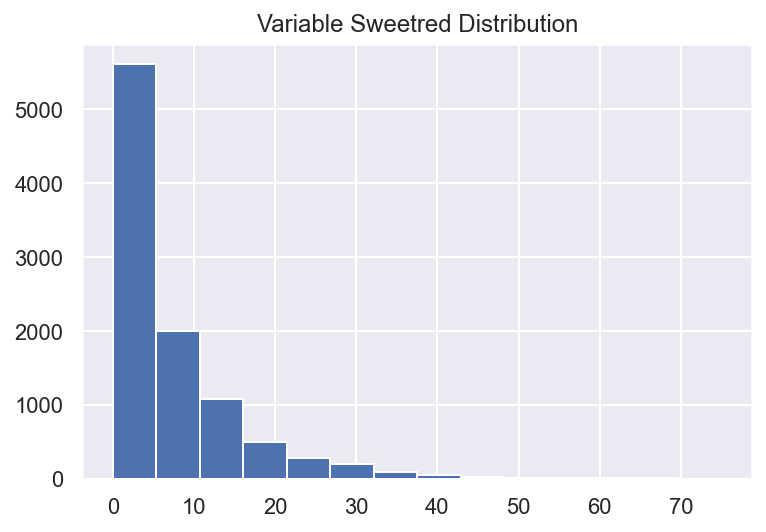

In [84]:
#plotting the histogram for Sweetred variable
plt.hist(buyingbehaviour_dataset["Sweetred"], bins=sturges_bins)
plt.title("Variable Sweetred Distribution")
plt.show()

Text(0.5, 1.0, 'Box Plot of Sweetred Variable')

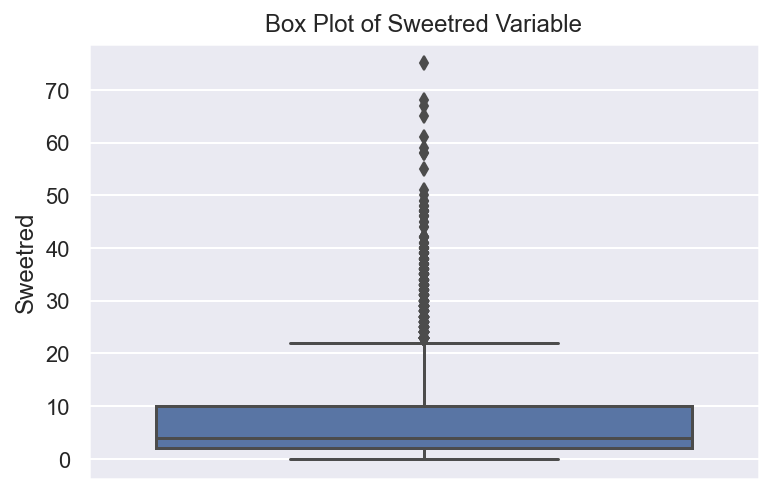

In [85]:
#plotting the boxplot for Sweetred variable
sns.boxplot(y=buyingbehaviour_dataset["Sweetred"])
plt.title("Box Plot of Sweetred Variable")

We observe a considerable ammount of clients with an extraordinary preference on sweet redwine.

For this reason, we can't afford to disregard this important group of clients.

**We check on the possibility of letting drop record with a value superior to 45 on this variable.**

In [86]:
counter_manual_Sweetred = (buyingbehaviour_dataset['Sweetred']>45).sum()
data_percentagekept(counter_manual_Sweetred)

Percentage of data kept after removing outliers: 99.73


**Time to manage the odd values recorded in *Variable Sweetwh*.**

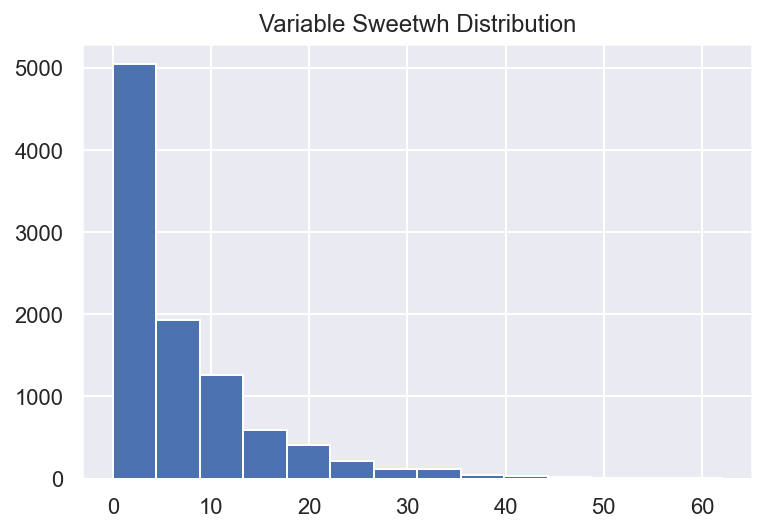

In [87]:
#plotting the histogram for Sweetred variable
plt.hist(buyingbehaviour_dataset["Sweetwh"], bins=sturges_bins)
plt.title("Variable Sweetwh Distribution")
plt.show()

Text(0.5, 1.0, 'Box Plot of Sweetwh Variable')

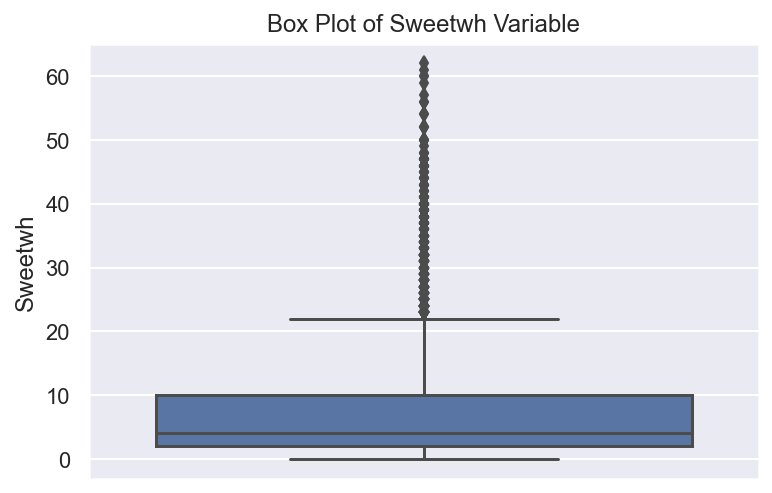

In [88]:
#plotting the boxplot for Sweetwh variable
sns.boxplot(y=buyingbehaviour_dataset["Sweetwh"])
plt.title("Box Plot of Sweetwh Variable")

We observe a considerable ammount of clients with an extraordinary preference on sweet whitewine.

For this reason, we can't afford to disregard this important group of clients.

**We check on the possibility of letting drop record with a value superior to 45 on this variable.**

In [89]:
counter_manual_Sweetwh = (buyingbehaviour_dataset['Sweetwh']>45).sum()
data_percentagekept(counter_manual_Sweetwh)

Percentage of data kept after removing outliers: 99.63


*Variable Dessert* **...**

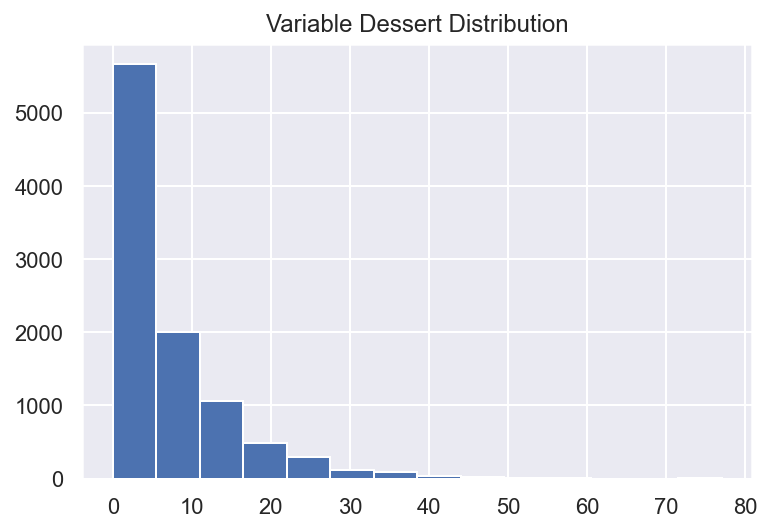

In [90]:
#plotting the histogram for Dessert variable
plt.hist(buyingbehaviour_dataset["Dessert"], bins=sturges_bins)
plt.title("Variable Dessert Distribution")
plt.show()

Text(0.5, 1.0, 'Box Plot of Dessert Variable')

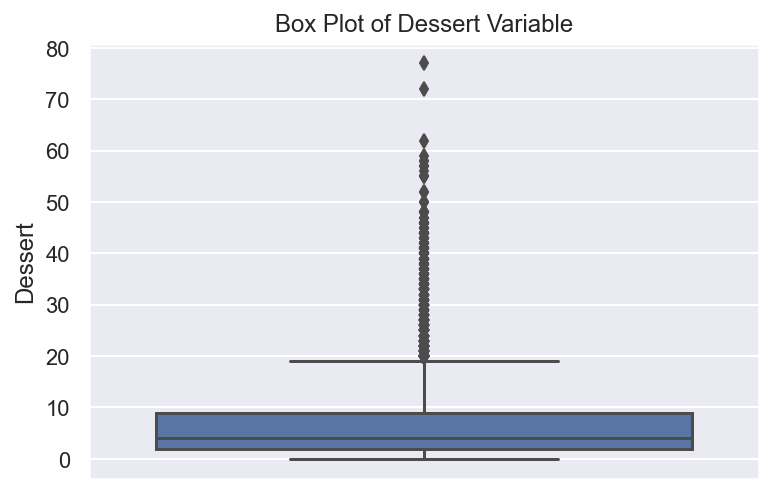

In [91]:
#plotting the boxplot for Dessert variable
sns.boxplot(y=buyingbehaviour_dataset["Dessert"])
plt.title("Box Plot of Dessert Variable")

We observe a considerable ammount of clients with an extraordinary preference on dessert wines.

For this reason, we can't afford to disregard this important group of clients.

**We check on the possibility of letting drop record with a value superior to 40 on this variable.**

In [92]:
counter_manual_Dessert = (buyingbehaviour_dataset['Dessert']>40).sum()
data_percentagekept(counter_manual_Dessert)

Percentage of data kept after removing outliers: 99.36


**Finally *Variable Exotic* ...**

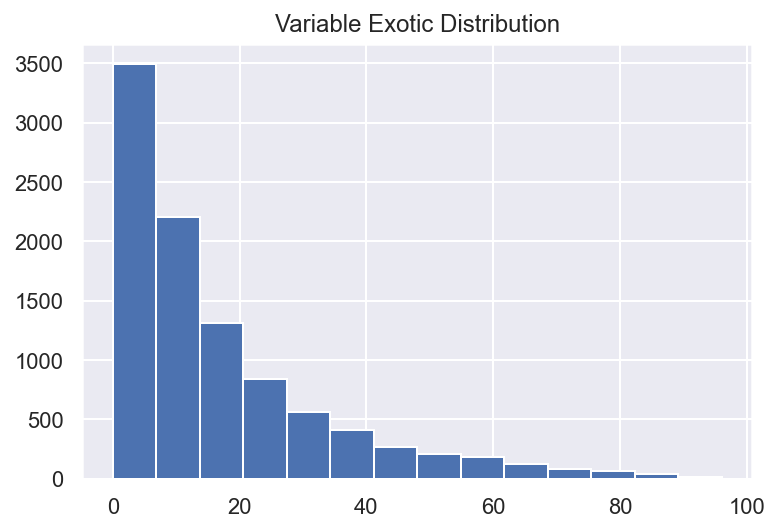

In [93]:
#plotting the histogram for Exotic variable
plt.hist(buyingbehaviour_dataset["Exotic"], bins=sturges_bins)
plt.title("Variable Exotic Distribution")
plt.show()

Text(0.5, 1.0, 'Box Plot of Exotic Variable')

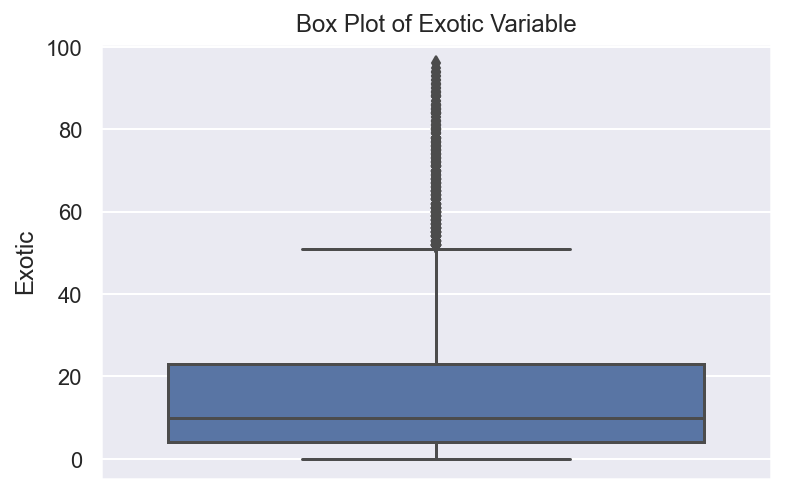

In [94]:
#plotting the boxplot for Exotic variable
sns.boxplot(y=buyingbehaviour_dataset["Exotic"])
plt.title("Box Plot of Exotic Variable")

We observe a considerable ammount of clients with an extraordinary preference on exotic wines.

For this reason, we can't afford to disregard this important group of clients.

**We check on the possibility of letting drop record with a value superior to 70 on this variable.**

In [95]:
counter_manual_Exotic = (buyingbehaviour_dataset['Exotic']>70).sum()
data_percentagekept(counter_manual_Exotic)

Percentage of data kept after removing outliers: 98.18


**We check the min % of data kept by after applying both combined IQR and manual processes on outliers' removal for the variables within Buying behaviour dataset.**

In [96]:
counter_combined_buyingbehaviour = counter_buyingbehaviour + counter_manual_Sweetred + counter_IQR_Drywh + counter_manual_Sweetwh + counter_manual_Dessert + counter_manual_Exotic
data_percentagekept(counter_combined_buyingbehaviour)

Percentage of data kept after removing outliers: 96.6


**We agree on this possibility.**

In [97]:
#redefine counter for Buying Behaviour ammount of records removed
#counter_clientsprofile = counter_combined

outliers_dataset = pd.concat([outliers_dataset, combined_dataset[combined_dataset['Sweetred']>(45)]])
combined_dataset = combined_dataset[combined_dataset['Sweetred']<=(45)]
outliers_dataset = pd.concat([outliers_dataset, combined_dataset[combined_dataset['Drywh']<(Q1_Drywh-1.5*(IQR_Drywh))]])
combined_dataset = combined_dataset[combined_dataset['Drywh']>=(Q1_Drywh-1.5*(IQR_Drywh))]
outliers_dataset = pd.concat([outliers_dataset, combined_dataset[combined_dataset['Drywh']>(Q3_Drywh+1.5*(IQR_Drywh))]])
combined_dataset = combined_dataset[combined_dataset['Drywh']<=(Q3_Drywh+1.5*(IQR_Drywh))]
outliers_dataset = pd.concat([outliers_dataset, combined_dataset[combined_dataset['Sweetwh']>(45)]])
combined_dataset = combined_dataset[combined_dataset['Sweetwh']<=(45)]
outliers_dataset = pd.concat([outliers_dataset, combined_dataset[combined_dataset['Dessert']>(40)]])
combined_dataset = combined_dataset[combined_dataset['Dessert']<=(40)]
outliers_dataset = pd.concat([outliers_dataset, combined_dataset[combined_dataset['Exotic']>(70)]])
combined_dataset = combined_dataset[combined_dataset['Exotic']<=(70)]

clientprofile_dataset = combined_dataset[clientprofile_variables]
buyingbehaviour_dataset = combined_dataset[buyingbehaviour_variables]

Text(0.5, 0.98, 'Histplots after outliers removement')

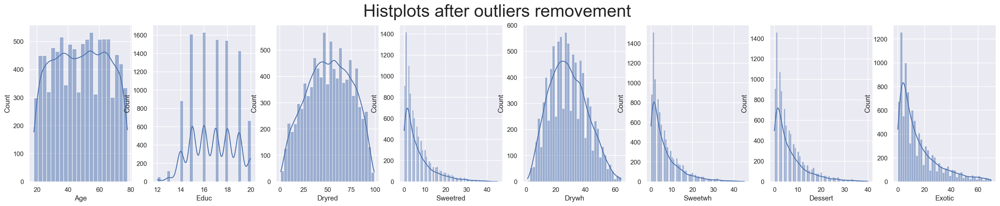

In [98]:
plt.figure(figsize = (30, 5))
for i in enumerate(buyingbehaviour_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=buyingbehaviour_dataset,kde=True)
plt.suptitle("Histplots after outliers removement", fontsize=30)

**Check on the % of data kept.**

In [99]:
counter = 10000-len(combined_dataset)
data_percentagekept(counter)

Percentage of data kept after removing outliers: 94.95


## 3.2 Datasets' Normalization
**We begin the data normalization process.**

A well conducted clustering process is deeply relying on this step.

As there are several processes for data normalization we go through some of this processes for each dataset and see how each one would impact our datasets.

In [100]:
#backup on both datasets and variables lists for safety programmatin procedures
clientprofile_dataset_backup4 = clientprofile_dataset.copy()
buyingbehaviour_dataset_backup4 = buyingbehaviour_dataset.copy()
clientprofile_variables_backup4 = clientprofile_variables.copy()
buyingbehaviour_variables_backup4 = buyingbehaviour_variables.copy()

In [101]:
#whole step reset
#clientprofile_dataset = clientprofile_dataset_backup4
#buyingbehaviour_dataset = buyingbehaviour_dataset_backup4
#clientprofile_variables = clientprofile_variables_backup4
#buyingbehaviour_variables = buyingbehaviour_variables_backup4

In [102]:
######################################################################################

In [103]:
#we drop categorical variable Kidhome from Client's Profile dataset
clientprofile_cluster = clientprofile_dataset.drop(columns=['Kidhome'])

#we drop categorical variables Kidhome and Teenhome from Buying Behaviour dataset
buyingbehaviour_cluster = buyingbehaviour_dataset.drop(columns=['Teenhome'])

### 3.2.1 Client's Profile

#### [3.2.1.1 Minmax normalization](#normalizationcp_decision) </font> <a class="anchor" id="minmaxcp"></a>

In [104]:
#reset...
#clientprofile_dataset = clientprofile_dataset_backup4
#clientprofile_variables = clientprofile_variables_backup4

In [105]:
#MinMax Normalization
clientprofile_dataset_minmax = clientprofile_cluster.copy()
scaler_minmax_cp = MinMaxScaler()
minmax_feat_cp = scaler_minmax_cp.fit_transform(clientprofile_dataset_minmax)
minmaxfeatures_cp = scaler_minmax_cp.get_feature_names_out()
clientprofile_dataset_minmax[minmaxfeatures_cp] = minmax_feat_cp

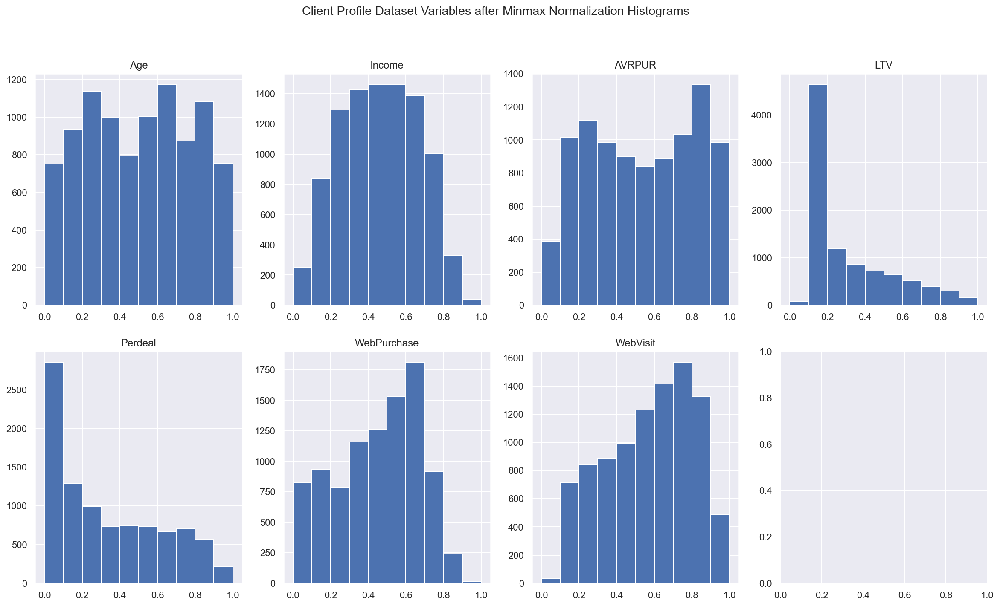

In [106]:
#ploting histograms for variables within the most updated Client Profile dataset
plot_multiple_histograms(clientprofile_dataset_minmax, clientprofile_variables_metric, 'Client Profile Dataset Variables after Minmax Normalization Histograms')

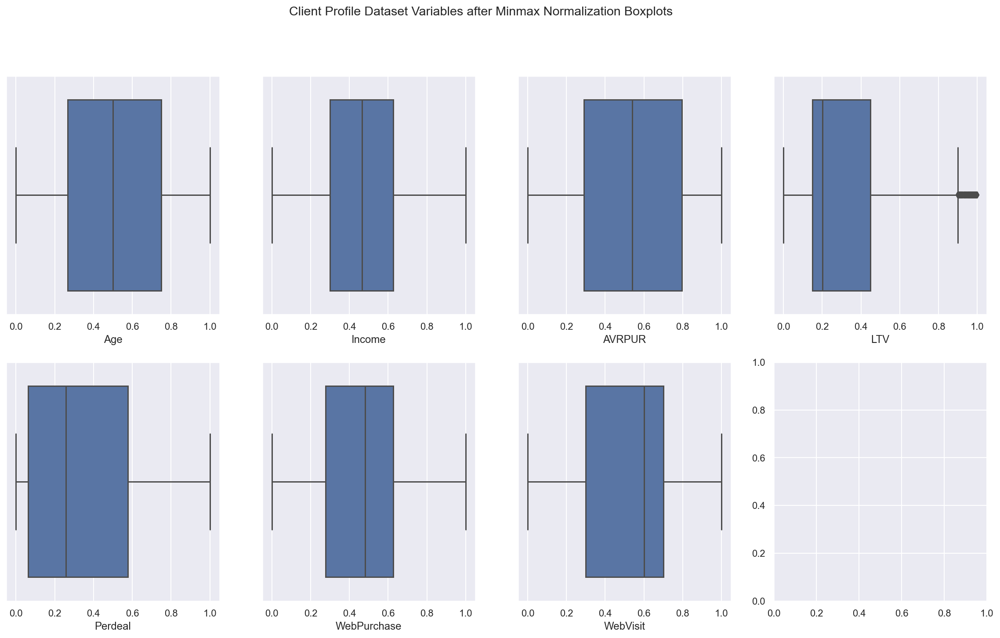

In [107]:
#ploting boxplots for variables within the most updated Client Profile dataset
plot_multiple_boxplots(clientprofile_dataset_minmax, clientprofile_variables_metric, 'Client Profile Dataset Variables after Minmax Normalization Boxplots')

Text(0.5, 0.98, 'Histplots for outliers detection after MinMax Normalization')

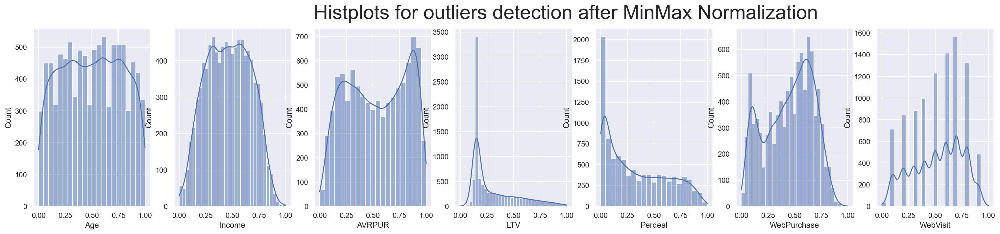

In [108]:
plt.figure(figsize = (30, 5))
for i in enumerate(clientprofile_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=clientprofile_dataset_minmax,kde=True)
plt.suptitle("Histplots for outliers detection after MinMax Normalization", fontsize=30)

#### 3.2.1.2 Standard Normalization

In [109]:
#Standard Normalization
clientprofile_dataset_standard = clientprofile_cluster.copy()
scaler_standard_cp = StandardScaler()
standard_feat_bb = scaler_standard_cp.fit_transform(clientprofile_dataset_standard)
standardfeatures_bb = scaler_standard_cp.get_feature_names_out()
clientprofile_dataset_standard[standardfeatures_bb] = standard_feat_bb

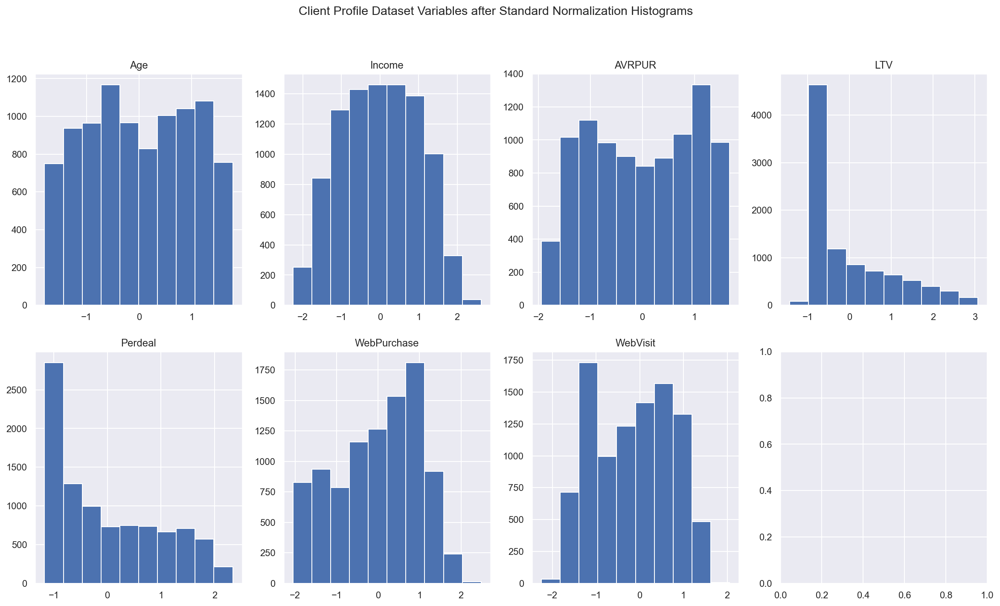

In [110]:
#ploting histograms for variables within the most updated Client Profile dataset
plot_multiple_histograms(clientprofile_dataset_standard, clientprofile_variables_metric, 'Client Profile Dataset Variables after Standard Normalization Histograms')

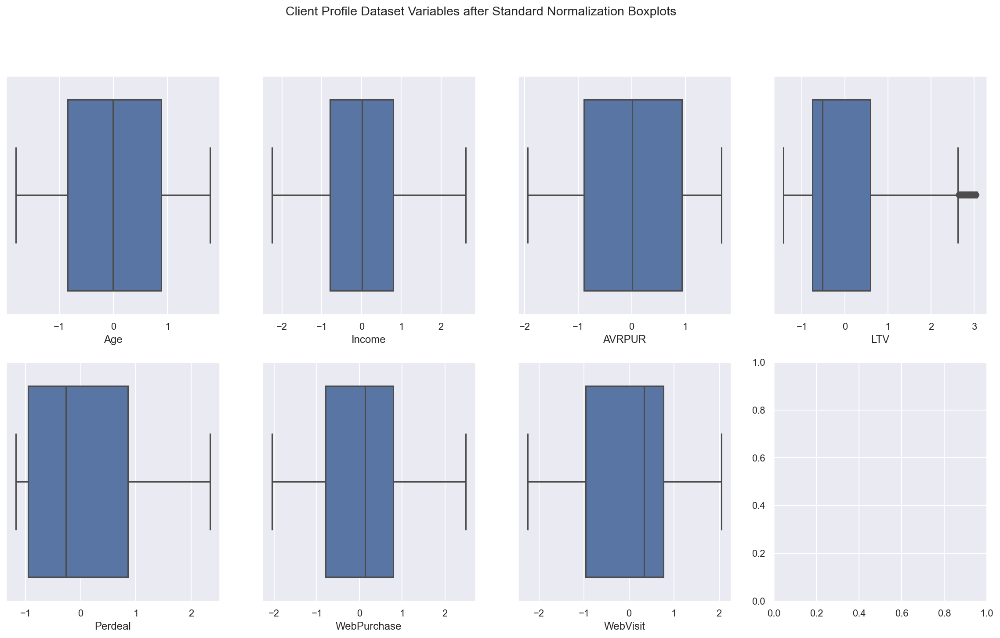

In [111]:
#ploting boxplots for variables within the most updated Client Profile dataset
plot_multiple_boxplots(clientprofile_dataset_standard, clientprofile_variables_metric, 'Client Profile Dataset Variables after Standard Normalization Boxplots')

Text(0.5, 0.98, 'Histplots for outliers detection after Standard Normalization')

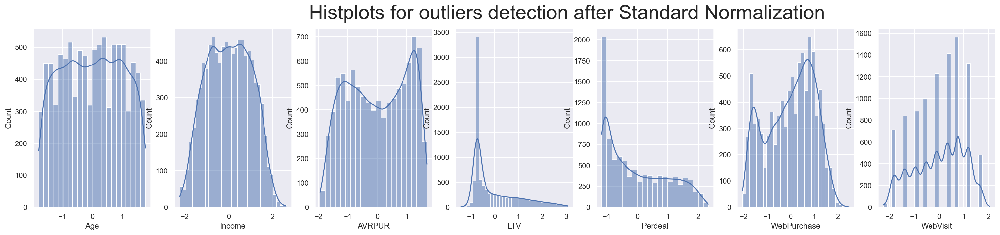

In [112]:
plt.figure(figsize = (30, 5))
for i in enumerate(clientprofile_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=clientprofile_dataset_standard,kde=True)
plt.suptitle("Histplots for outliers detection after Standard Normalization", fontsize=30)

#### 3.2.1.3 Z-Score Normalization

In [113]:
#Z-Score Normalization
clientprofile_dataset_zscore = clientprofile_cluster.apply(stats.zscore)

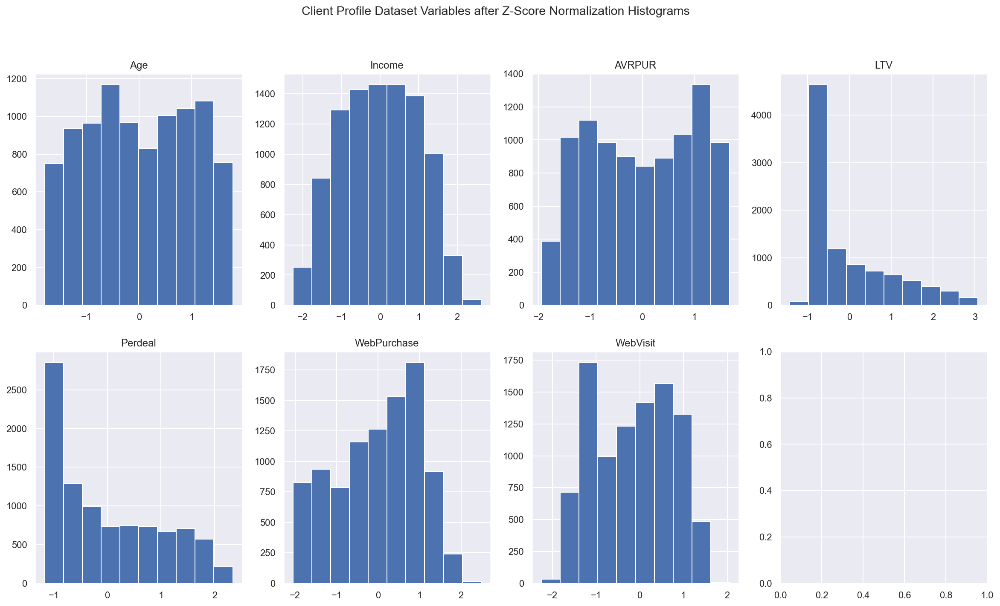

In [114]:
#ploting histograms for variables within the most updated Client Profile dataset
plot_multiple_histograms(clientprofile_dataset_zscore, clientprofile_variables_metric, 'Client Profile Dataset Variables after Z-Score Normalization Histograms')

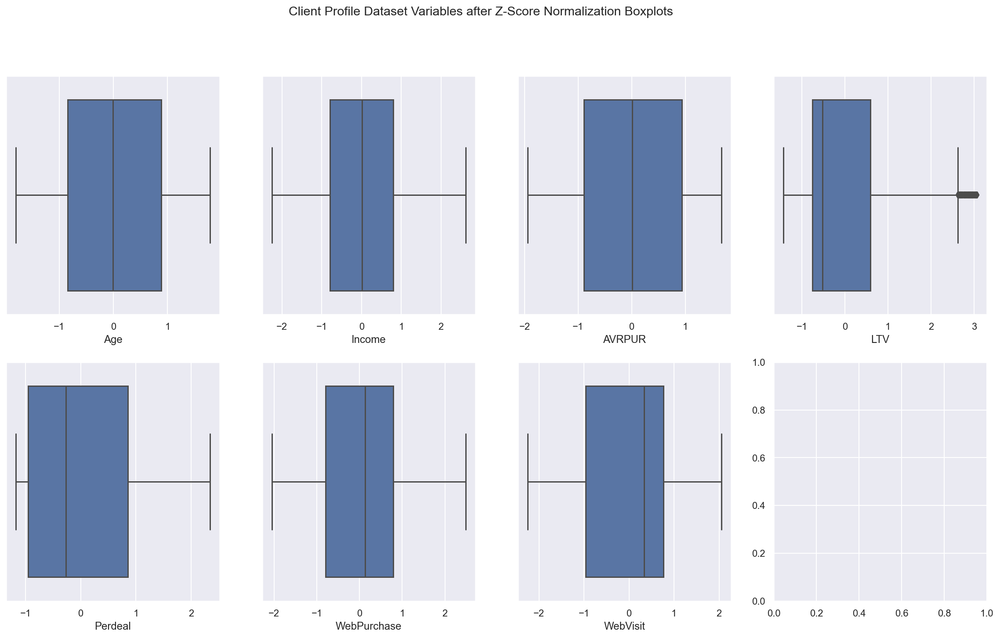

In [115]:
#ploting boxplots for variables within the most updated Client Profile dataset
plot_multiple_boxplots(clientprofile_dataset_zscore, clientprofile_variables_metric, 'Client Profile Dataset Variables after Z-Score Normalization Boxplots')

Text(0.5, 0.98, 'Histplots for outliers detection after Z-Score')

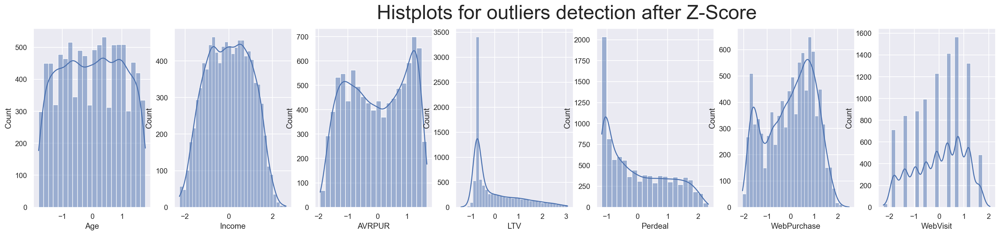

In [116]:
plt.figure(figsize = (30, 5))
for i in enumerate(clientprofile_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=clientprofile_dataset_zscore,kde=True)
plt.suptitle("Histplots for outliers detection after Z-Score", fontsize=30)

#### 3.2.1.4 Decision

[**We choose to use the MinMax normalization technique.**](#minmaxcp) </font> <a class="anchor" id="normalizationcp_decision"></a>

After analysing the boxplots pre and after normalization we believe that this is the technique that at the same time maintains a more similar structure.

To the real values and at the same time softens the values to a better clustering formation.

In [117]:
#we create a backup for the dataset with the real values
clientprofile_cluster_realvalues = clientprofile_cluster.copy()
clientprofile_cluster = clientprofile_dataset_minmax.copy()

### 3.2.2 Buying Behaviour

#### [3.2.2.1 Minmax Normalization](#normalizationbb_decision) </font> <a class="anchor" id="minmaxbb"></a>

In [118]:
#reset...
#buyingbehaviour_cluster = buyingbehaviour_dataset_backup4
#buyingbehaviour_variables_metric = buyingbehaviour_variables_backup4

In [119]:
#MinMax Normalization
buyingbehaviour_dataset_minmax = buyingbehaviour_cluster.copy()
scaler_minmax_bb = MinMaxScaler()
minmaxscale_bb = scaler_minmax_bb.fit_transform(buyingbehaviour_dataset_minmax)
minmaxfeatures_bb = scaler_minmax_bb.get_feature_names_out()
buyingbehaviour_dataset_minmax[minmaxfeatures_bb] = minmaxscale_bb

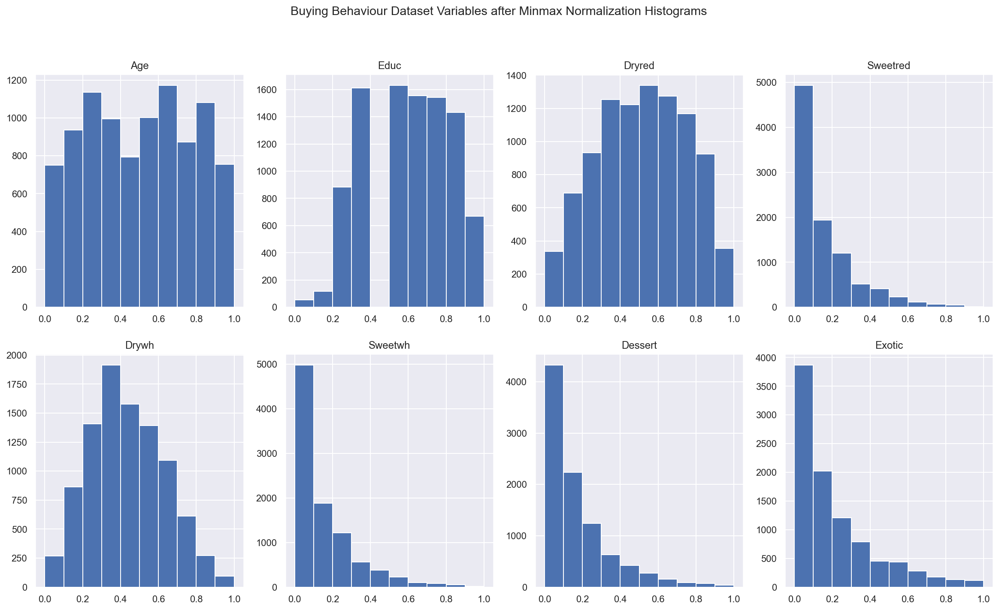

In [120]:
#ploting histograms for variables within the most updated Buying Behaviour dataset
plot_multiple_histograms(buyingbehaviour_dataset_minmax, buyingbehaviour_variables_metric, 'Buying Behaviour Dataset Variables after Minmax Normalization Histograms')

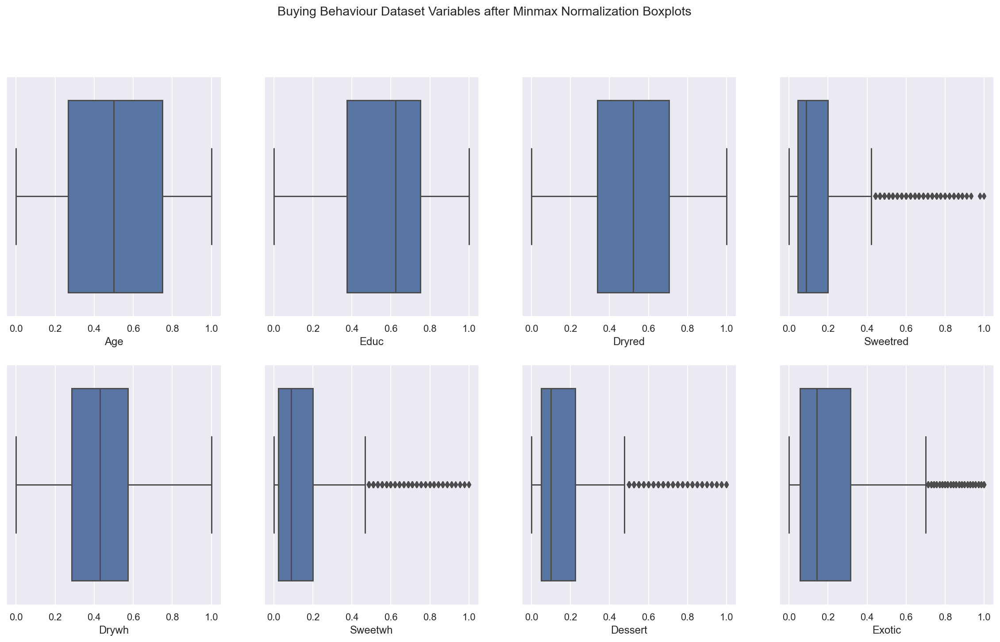

In [121]:
#ploting boxplots for variables within the most updated Buying Behaviour dataset
plot_multiple_boxplots(buyingbehaviour_dataset_minmax, buyingbehaviour_variables_metric, 'Buying Behaviour Dataset Variables after Minmax Normalization Boxplots')

Text(0.5, 0.98, 'Histplots for outliers detection after MinMax Normalization')

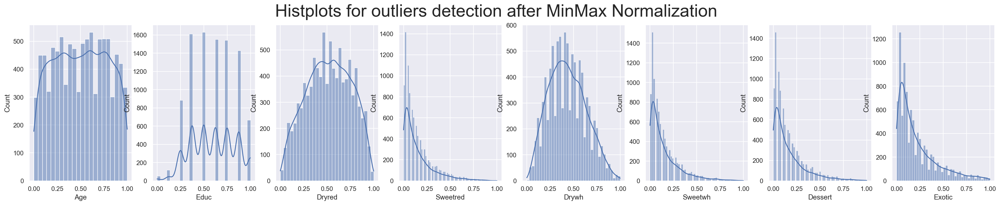

In [122]:
plt.figure(figsize = (30, 5))
for i in enumerate(buyingbehaviour_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=buyingbehaviour_dataset_minmax,kde=True)
plt.suptitle("Histplots for outliers detection after MinMax Normalization", fontsize=30)

#### 3.2.2.2 Standard Normalization

In [123]:
#Standard Normalization
buyingbehaviour_dataset_standard = buyingbehaviour_cluster.copy()
scaler_standard_bb = StandardScaler()
standard_feat_bb = scaler_standard_bb.fit_transform(buyingbehaviour_dataset_standard)
standardfeatures_bb = scaler_standard_bb.get_feature_names_out()
buyingbehaviour_dataset_standard[standardfeatures_bb] = standard_feat_bb

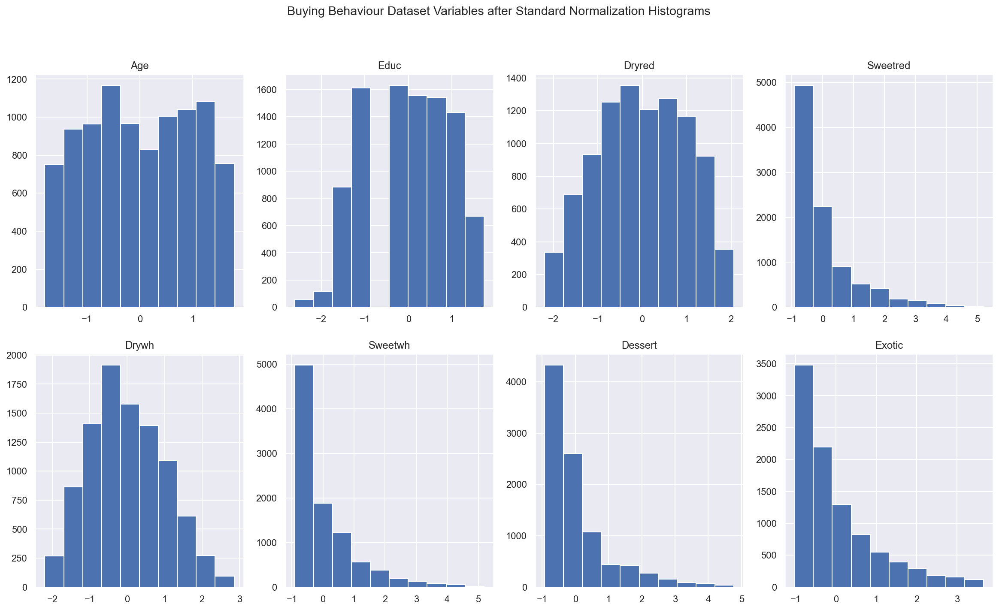

In [124]:
#ploting histograms for variables within the most updated Client Profile dataset
plot_multiple_histograms(buyingbehaviour_dataset_standard, buyingbehaviour_variables_metric, 'Buying Behaviour Dataset Variables after Standard Normalization Histograms')

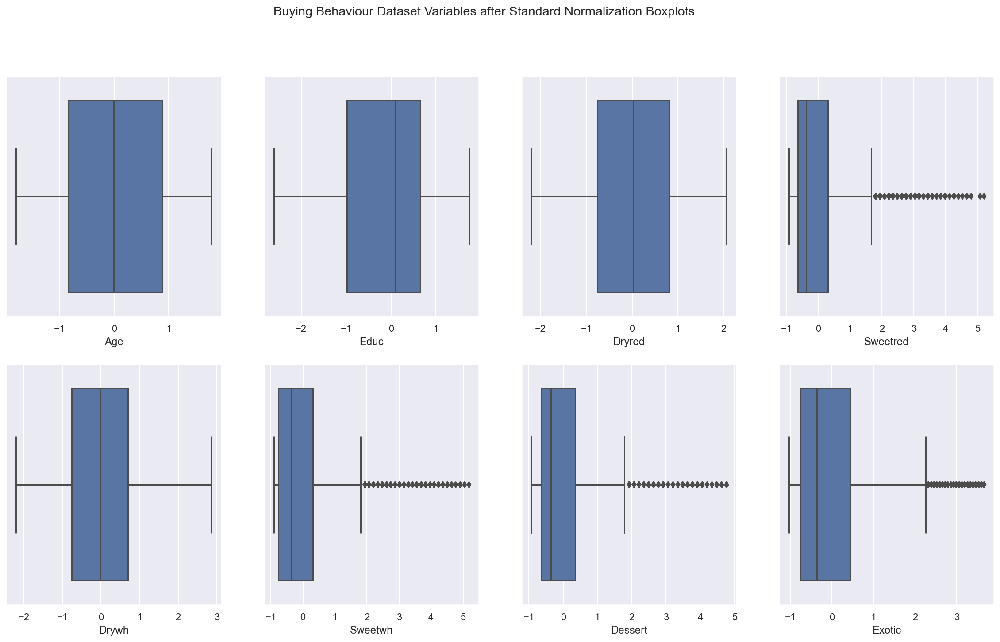

In [125]:
#ploting boxplots for variables within the most updated Buying Behaviour dataset
plot_multiple_boxplots(buyingbehaviour_dataset_standard, buyingbehaviour_variables_metric, 'Buying Behaviour Dataset Variables after Standard Normalization Boxplots')

Text(0.5, 0.98, 'Histplots for outliers detection after Standard Normalization')

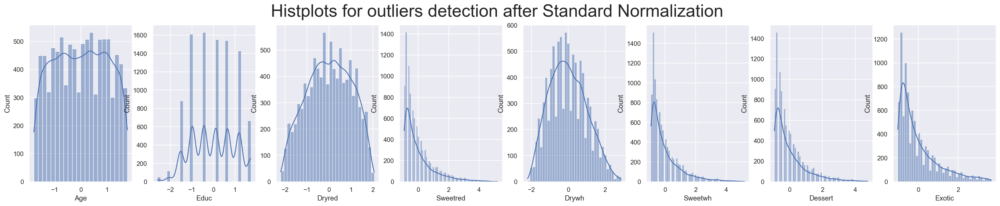

In [126]:
plt.figure(figsize = (30, 5))
for i in enumerate(buyingbehaviour_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=buyingbehaviour_dataset_standard,kde=True)
plt.suptitle("Histplots for outliers detection after Standard Normalization", fontsize=30)

#### 3.2.2.3 Z-Score Normalization

In [127]:
#Z-Score Normalization
buyingbehaviour_dataset_zscore = buyingbehaviour_cluster.apply(stats.zscore)

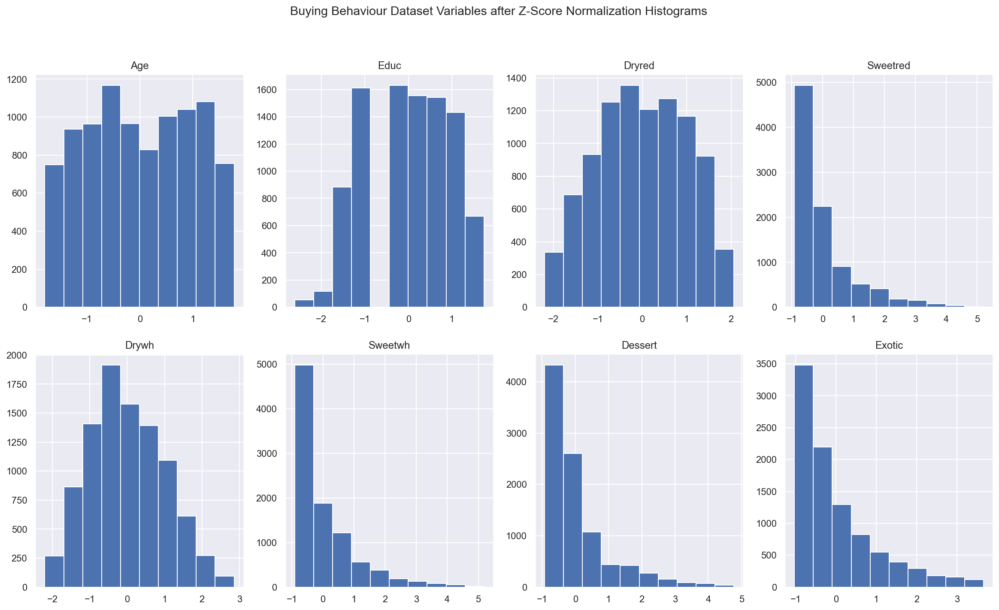

In [128]:
#ploting histograms for variables within the most updated Buying Behaviour dataset
plot_multiple_histograms(buyingbehaviour_dataset_zscore, buyingbehaviour_variables_metric, 'Buying Behaviour Dataset Variables after Z-Score Normalization Histograms')

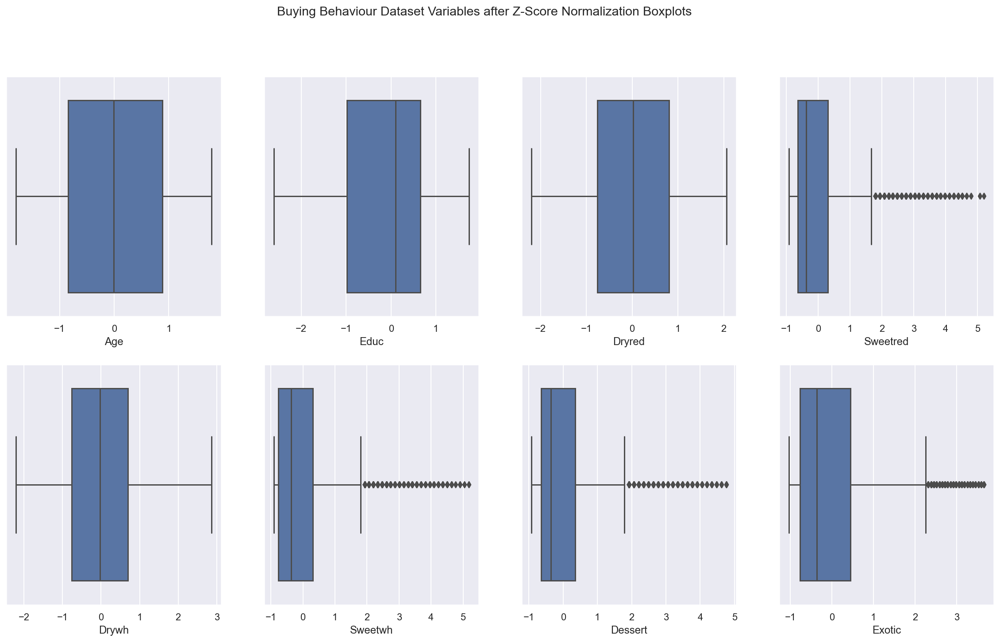

In [129]:
#ploting boxplots for variables within the most updated Buying Behaviour dataset
plot_multiple_boxplots(buyingbehaviour_dataset_zscore, buyingbehaviour_variables_metric, 'Buying Behaviour Dataset Variables after Z-Score Normalization Boxplots')

Text(0.5, 0.98, 'Histplots for outliers detection after Z-Score')

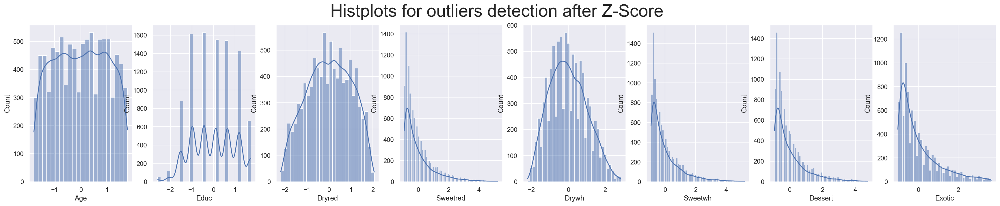

In [130]:
plt.figure(figsize = (30, 5))
for i in enumerate(buyingbehaviour_variables_metric):
    plt.subplot(1, 8,i[0]+1)
    sns.histplot(x=i[1], data=buyingbehaviour_dataset_zscore,kde=True)
plt.suptitle("Histplots for outliers detection after Z-Score", fontsize=30)

#### 3.2.2.4 Decision

[**We choose the MinMax normalization method.**](#minmaxbb) </font> <a class="anchor" id="normalizationbb_decision"></a>

After choosing this technique for the Client's Profile, choosing the same one for the Buying Behaviour one would be the one that would get our job more easier.

After we check the graphs and boxplots we decided we could go on with this procedure.

In [131]:
#we create a backup for the dataset with the real values
buyingbehaviour_cluster_realvalues = buyingbehaviour_cluster.copy()
buyingbehaviour_cluster = buyingbehaviour_dataset_minmax.copy()

# <font color='#5E2190'>4. Clustering </font> <a class="anchor" id="Clustering"></a>
**We start our segmentation process.**

**We apply different segmentation techniques to both datasets to check on which fits best our goals.**

[To Index](#toc) 

In [132]:
#safety programmation measures...
clientprofile_cluster_realvalues_backup = clientprofile_cluster_realvalues.copy()
buyingbehaviour_cluster_realvalues_backup = buyingbehaviour_cluster_realvalues.copy()

## 4.1 Client Profile

In [133]:
#checking variables list
clientprofile_variables_metric

['Age', 'Income', 'AVRPUR', 'LTV', 'Perdeal', 'WebPurchase', 'WebVisit']

In [134]:
# for graphic presentation purposes
clientprofile_cluster_labels = clientprofile_cluster.copy()

### 4.1.1 K Means

**We begin by checking the 'ideally desired' number of clusters using the PCA process**

In [135]:
# creating a PCA instance 
pca_cp = PCA(n_components = 7)
principalComponents_cp = pca_cp.fit_transform(clientprofile_cluster)

# saving components to a DataFrame
PCA_components_cp = pd.DataFrame(principalComponents_cp)

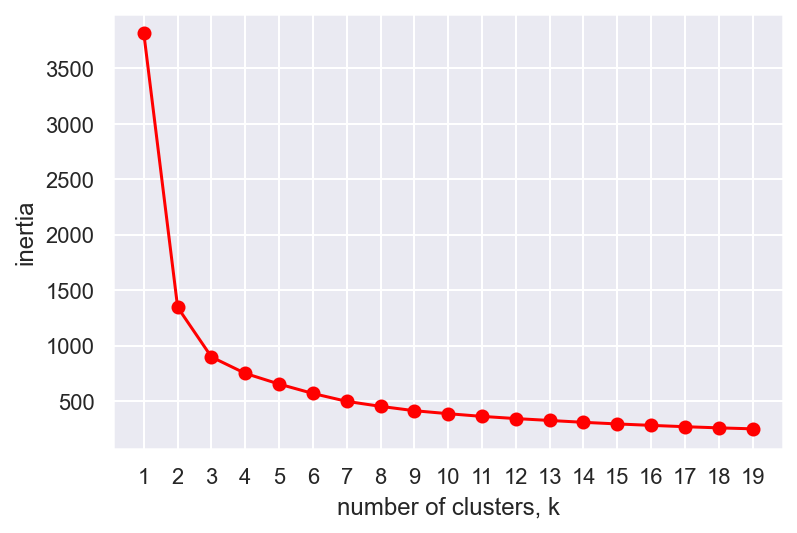

In [136]:
#finding the number of clusters
ks = range(1, 20)
inertias = []
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k, n_init=20)
    
    # Fit model to samples
    model.fit(PCA_components_cp.iloc[:,:3])
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
plt.plot(ks, inertias, '-o', color='red')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()

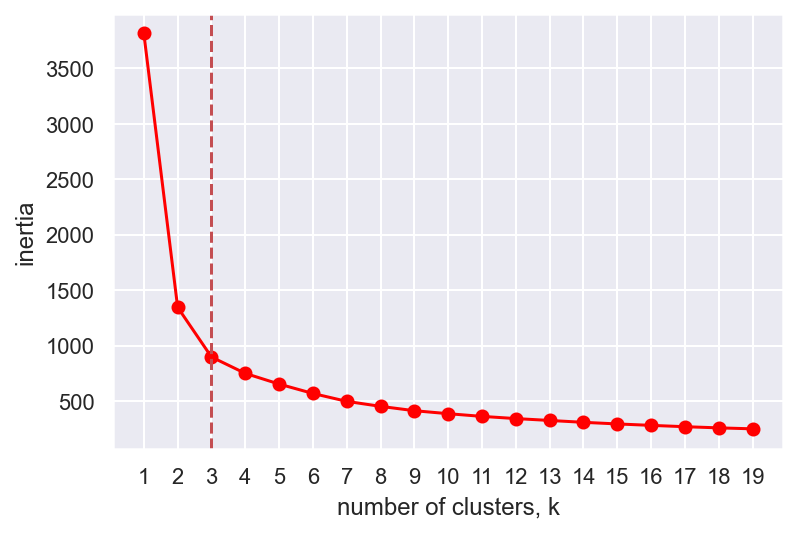

In [137]:
plt.plot(ks, inertias, '-o', color='red')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.axvline(x=3, color='r', linestyle='--')
plt.show()

We choose to segment clients into 3 different groups, following the "elbow rule".

In [138]:
#clustering the records...

In [139]:
clientprofile_kmclust = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=1)
clientprofile_kmclust.fit(clientprofile_cluster)

KMeans(n_clusters=3, n_init=20, random_state=1)

In [140]:
clusters_km_cp = clientprofile_kmclust.predict(clientprofile_cluster)

In [141]:
clientprofile_cluster_realvalues['KM_Clust'] = clusters_km_cp
clientprofile_cluster_labels['KM_Clust'] = clusters_km_cp

**Let's have a look at some brief statistics for our clusters.**

In [142]:
clientprofile_cluster_realvalues.groupby('KM_Clust').mean()[clientprofile_variables_metric]

,Age,Income,AVRPUR,LTV,Perdeal,WebPurchase,WebVisit
KM_Clust,,,,,,,
0,68.217674,101355.302984,47.491465,549.568860,3.786534,19.928080,2.671385
1,31.999237,44784.999491,19.034197,-5.141949,59.377766,56.620198,6.722971
2,51.794915,75947.574576,35.469122,146.725763,21.702034,43.723390,5.501695


*Variable Age*

In [143]:
clientprofile_cluster_realvalues.groupby('KM_Clust').describe()['Age']

,count,mean,std,min,25%,50%,75%,max
KM_Clust,,,,,,,,
0,2614.0,68.217674,5.944994,46.0,64.0,68.0,73.0,78.0
1,3931.0,31.999237,8.286858,18.0,25.0,32.0,38.0,56.0
2,2950.0,51.794915,8.108683,21.0,47.0,52.0,57.0,78.0


*Variable Income*

In [144]:
clientprofile_cluster_realvalues.groupby('KM_Clust').describe()['Income']

,count,mean,std,min,25%,50%,75%,max
KM_Clust,,,,,,,,
0,2614.0,101355.302984,11512.814798,65967.0,93240.5,101039.0,109424.75,139730.0
1,3931.0,44784.999491,14087.468376,10000.0,34521.0,45274.0,54867.50,84752.0
2,2950.0,75947.574576,12080.430456,37622.0,67738.5,76159.0,84001.00,121029.0


*Variable AVRPUR*

In [145]:
clientprofile_cluster_realvalues.groupby('KM_Clust').describe()['AVRPUR']

,count,mean,std,min,25%,50%,75%,max
KM_Clust,,,,,,,,
0,2614.0,47.491465,4.246045,25.33,45.17,48.38,50.6500,54.41
1,3931.0,19.034197,6.639868,6.00,14.00,18.33,23.6000,40.89
2,2950.0,35.469122,7.253745,13.75,30.40,35.87,40.9875,52.05


*Variable LTV*

In [146]:
clientprofile_cluster_realvalues.groupby('KM_Clust').describe()['LTV']

,count,mean,std,min,25%,50%,75%,max
KM_Clust,,,,,,,,
0,2614.0,549.568860,204.040871,59.0,390.25,536.0,700.0,999.0
1,3931.0,-5.141949,19.080363,-178.0,-9.00,-3.0,1.0,103.0
2,2950.0,146.725763,125.876526,-124.0,50.00,115.0,216.0,753.0


*Variable Perdeal*

In [147]:
clientprofile_cluster_realvalues.groupby('KM_Clust').describe()['Perdeal']

,count,mean,std,min,25%,50%,75%,max
KM_Clust,,,,,,,,
0,2614.0,3.786534,4.001382,0.0,1.0,2.0,5.0,28.0
1,3931.0,59.377766,18.934923,8.0,46.0,61.0,75.0,97.0
2,2950.0,21.702034,12.723273,1.0,12.0,19.0,29.0,75.0


*Variable WebPurchase*

In [148]:
clientprofile_cluster_realvalues.groupby('KM_Clust').describe()['WebPurchase']

,count,mean,std,min,25%,50%,75%,max
KM_Clust,,,,,,,,
0,2614.0,19.928080,9.833837,5.0,13.0,17.0,26.0,61.0
1,3931.0,56.620198,10.470630,16.0,50.0,58.0,64.0,88.0
2,2950.0,43.723390,11.264481,13.0,35.0,44.0,53.0,78.0


*Variable WebVisit*

In [149]:
clientprofile_cluster_realvalues.groupby('KM_Clust').describe()['WebVisit']

,count,mean,std,min,25%,50%,75%,max
KM_Clust,,,,,,,,
0,2614.0,2.671385,1.614932,0.0,1.0,2.0,4.0,9.0
1,3931.0,6.722971,1.535775,1.0,6.0,7.0,8.0,10.0
2,2950.0,5.501695,1.757751,1.0,4.0,6.0,7.0,9.0


**We look at the clusters weights.**

In [150]:
clientprofile_cluster_realvalues.KM_Clust.value_counts(normalize = True)

1    0.414007
2    0.310690
0    0.275303
Name: KM_Clust, dtype: float64

**Lets have a look at the radar graph and the variables' distribution**

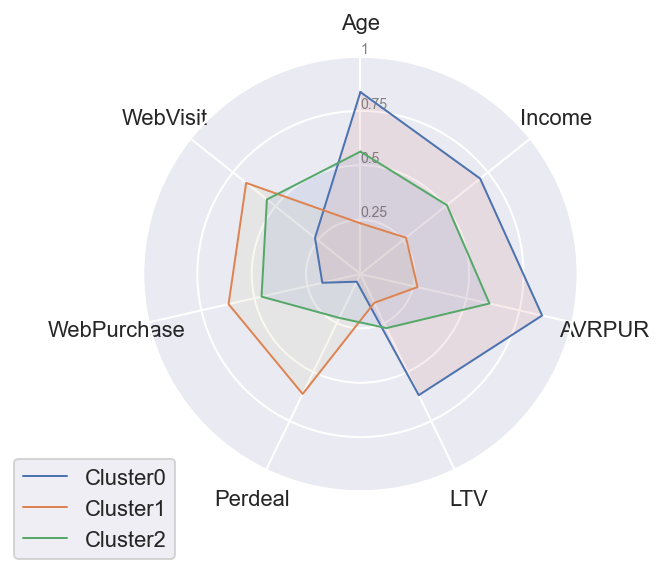

In [151]:
create_radar_graph(clientprofile_cluster_labels, clientprofile_variables_metric, 'KM_Clust')

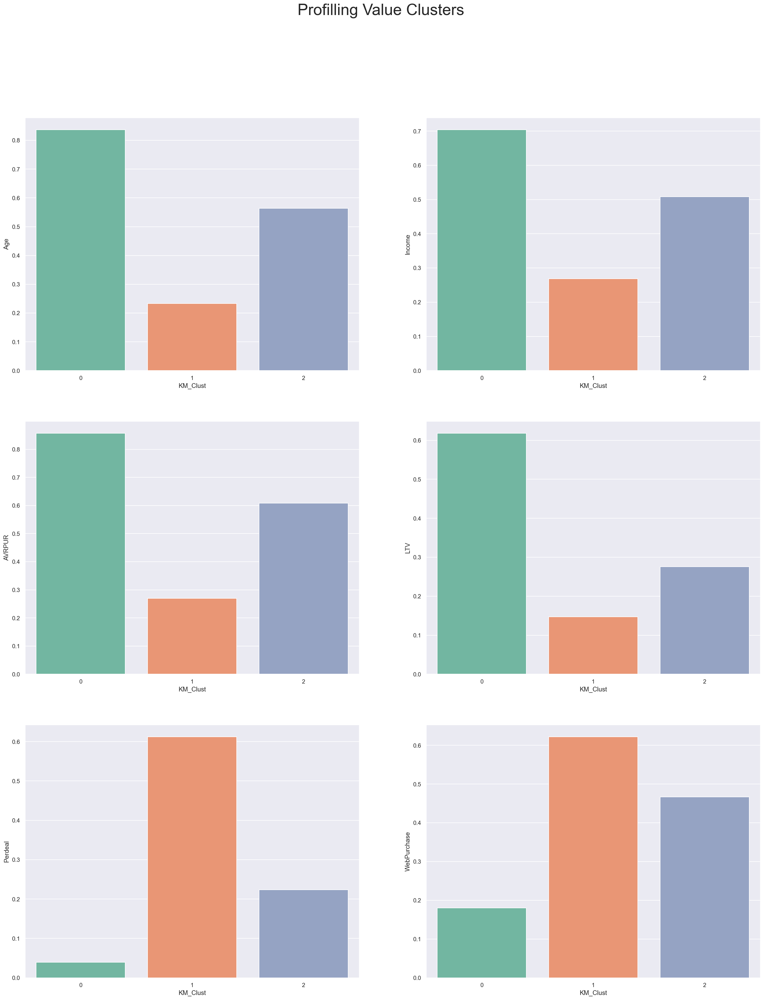

In [152]:
b = clientprofile_cluster_labels.groupby('KM_Clust').mean()

#sns.set(font_scale=1.7)
fig, axes = plt.subplots(3, 2, figsize=(25, 30))
for ax, feat in zip(axes.flatten(), b[clientprofile_variables_metric]):
    sns.barplot(x=b.index, y=feat, data=b, ax=ax, palette='Set2')
    
title = "Profilling Value Clusters"
plt.suptitle(title, size= 30)
plt.show()

**We finish by displaying a 2d plot clusters representation after a TSNE transformation.**

C:\Users\Raimundo\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\Raimundo\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


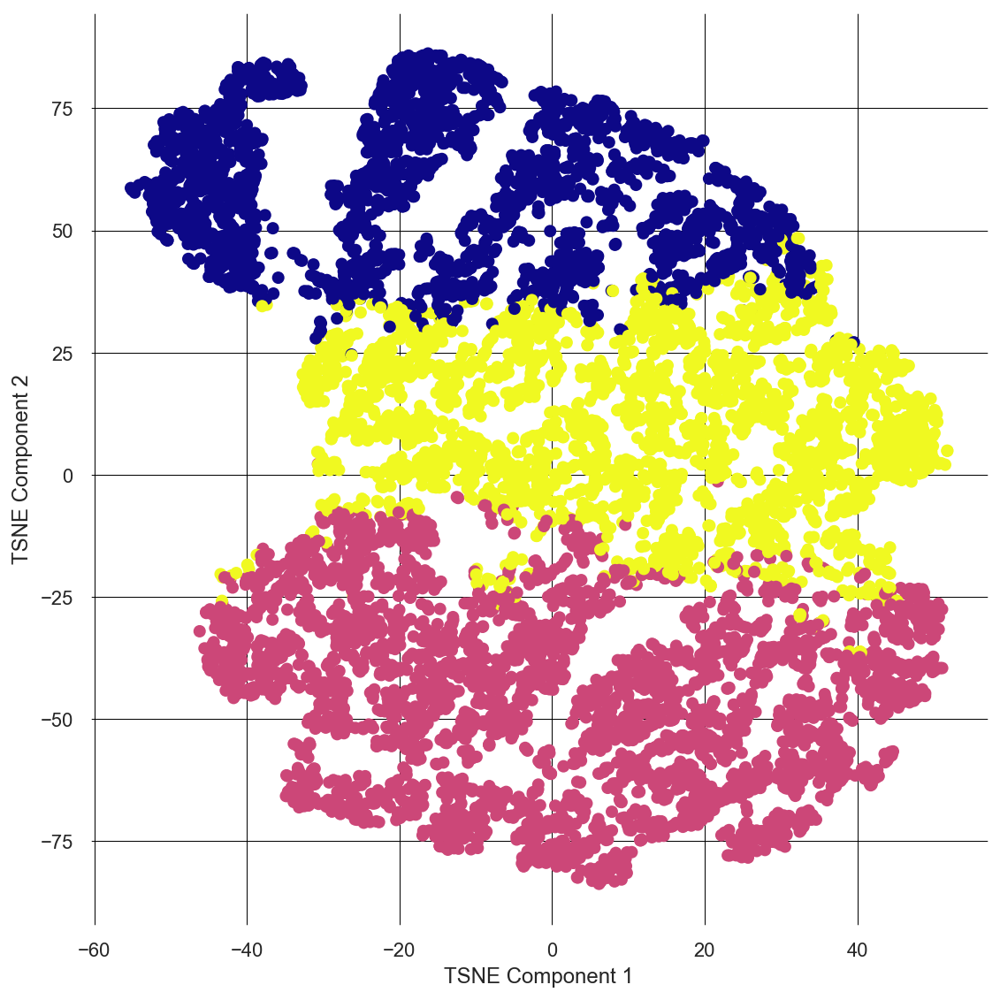

In [153]:
visualize_clusters(clientprofile_cluster_labels, 'KM_Clust', clientprofile_variables_metric)

### 4.1.2 Mean Shift 

In [154]:
# The following bandwidth can be automatically detected using (we need to set quantile though)
# Based on distance to nearest neighbors for all observations
bandwidth_cp = estimate_bandwidth(clientprofile_cluster, quantile=0.2, random_state=1, n_jobs=-1)
bandwidth_cp

0.4597275423936586

In [155]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms_cp = MeanShift(bandwidth=bandwidth_cp, bin_seeding=True, n_jobs=4)
ms_labels_cp = ms_cp.fit_predict(clientprofile_cluster)

ms_n_clusters_cp = len(np.unique(ms_labels_cp))
print("Number of estimated clusters : %d" % ms_n_clusters_cp)

Number of estimated clusters : 3


In [156]:
clientprofile_cluster_realvalues['MS_Clust'] = ms_labels_cp
clientprofile_cluster_labels['MS_Clust'] = ms_labels_cp

**Let's look at some brief statistics for our clusters.**

In [157]:
clientprofile_cluster_realvalues.groupby('MS_Clust').mean()[clientprofile_variables_metric]

,Age,Income,AVRPUR,LTV,Perdeal,WebPurchase,WebVisit
MS_Clust,,,,,,,
0,32.399365,45436.183928,19.397570,-3.942355,58.387396,56.465804,6.718124
1,52.671404,77318.385789,36.195577,161.175737,20.569151,42.886655,5.419757
2,68.483704,101732.376789,47.600215,556.577504,3.558426,19.376391,2.583863


*Variable Age*

In [158]:
clientprofile_cluster_realvalues.groupby('MS_Clust').describe()['Age']

,count,mean,std,min,25%,50%,75%,max
MS_Clust,,,,,,,,
0,4094.0,32.399365,8.498775,18.0,25.0,32.0,39.0,57.0
1,2885.0,52.671404,7.836808,22.0,48.0,53.0,58.0,78.0
2,2516.0,68.483704,5.839208,46.0,65.0,69.0,73.0,78.0


*Variable Income*

In [159]:
clientprofile_cluster_realvalues.groupby('MS_Clust').describe()['Income']

,count,mean,std,min,25%,50%,75%,max
MS_Clust,,,,,,,,
0,4094.0,45436.183928,14303.142416,10000.0,35064.00,45892.0,55799.00,87809.0
1,2885.0,77318.385789,11857.949225,37622.0,69221.00,77559.0,85344.00,121029.0
2,2516.0,101732.376789,11440.572843,68552.0,93756.75,101560.5,109776.25,139730.0


*Variable AVRPUR*

In [160]:
clientprofile_cluster_realvalues.groupby('MS_Clust').describe()['AVRPUR']

,count,mean,std,min,25%,50%,75%,max
MS_Clust,,,,,,,,
0,4094.0,19.397570,6.853719,6.00,14.00,18.67,24.00,43.23
1,2885.0,36.195577,7.190935,13.75,31.09,36.60,41.70,52.28
2,2516.0,47.600215,4.207024,25.33,45.33,48.52,50.71,54.41


*Variable LTV*

In [161]:
clientprofile_cluster_realvalues.groupby('MS_Clust').describe()['LTV']

,count,mean,std,min,25%,50%,75%,max
MS_Clust,,,,,,,,
0,4094.0,-3.942355,20.888173,-178.0,-9.00,-3.0,2.0,144.0
1,2885.0,161.175737,131.826268,-124.0,60.00,130.0,233.0,859.0
2,2516.0,556.577504,203.093295,59.0,400.75,542.0,707.0,999.0


*Variable Perdeal*

In [162]:
clientprofile_cluster_realvalues.groupby('MS_Clust').describe()['Perdeal']

,count,mean,std,min,25%,50%,75%,max
MS_Clust,,,,,,,,
0,4094.0,58.387396,19.384391,5.0,44.0,60.0,74.0,97.0
1,2885.0,20.569151,12.239936,1.0,11.0,18.0,27.0,75.0
2,2516.0,3.558426,3.752185,0.0,1.0,2.0,4.0,28.0


*Variable WebPurchase*

In [163]:
clientprofile_cluster_realvalues.groupby('MS_Clust').describe()['WebPurchase']

,count,mean,std,min,25%,50%,75%,max
MS_Clust,,,,,,,,
0,4094.0,56.465804,10.460806,16.0,50.0,57.0,64.0,88.0
1,2885.0,42.886655,11.177889,12.0,34.0,43.0,52.0,75.0
2,2516.0,19.376391,9.463807,5.0,12.0,16.0,24.0,59.0


*Variable WebVisit*

In [164]:
clientprofile_cluster_realvalues.groupby('MS_Clust').describe()['WebVisit']

,count,mean,std,min,25%,50%,75%,max
MS_Clust,,,,,,,,
0,4094.0,6.718124,1.534895,1.0,6.0,7.0,8.0,10.0
1,2885.0,5.419757,1.747266,1.0,4.0,5.0,7.0,9.0
2,2516.0,2.583863,1.551412,0.0,1.0,2.0,3.0,9.0


**We look at the clusters weights.**

In [165]:
clientprofile_cluster_realvalues.MS_Clust.value_counts(normalize = True)

0    0.431174
1    0.303844
2    0.264982
Name: MS_Clust, dtype: float64

**Let's have a look at the radar graph and the variables' distribution**

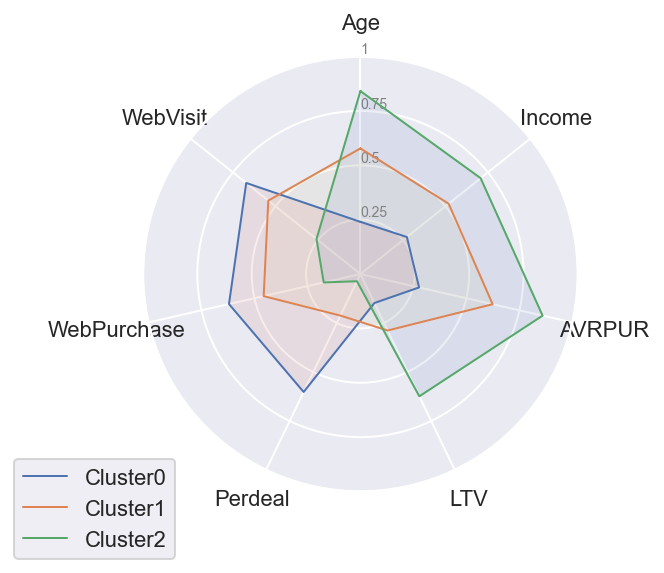

In [166]:
create_radar_graph(clientprofile_cluster_labels, clientprofile_variables_metric, 'MS_Clust')

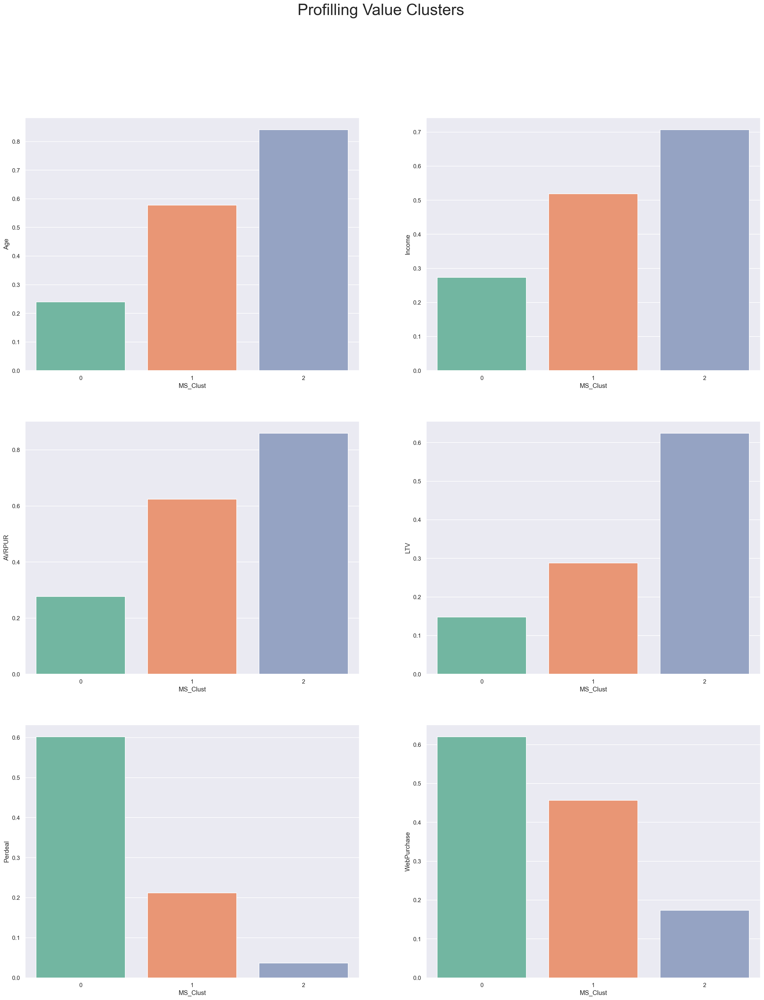

In [167]:
b = clientprofile_cluster_labels.groupby('MS_Clust').mean()

#sns.set(font_scale=1.7)
fig, axes = plt.subplots(3, 2, figsize=(25, 30))
for ax, feat in zip(axes.flatten(), b[clientprofile_variables_metric]):
    sns.barplot(x=b.index, y=feat, data=b, ax=ax, palette='Set2')
    
title = "Profilling Value Clusters"
plt.suptitle(title, size= 30)
plt.show()

**We finish by displaying a 2d plot clusters representation after a TSNE transformation.**

C:\Users\Raimundo\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\Raimundo\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


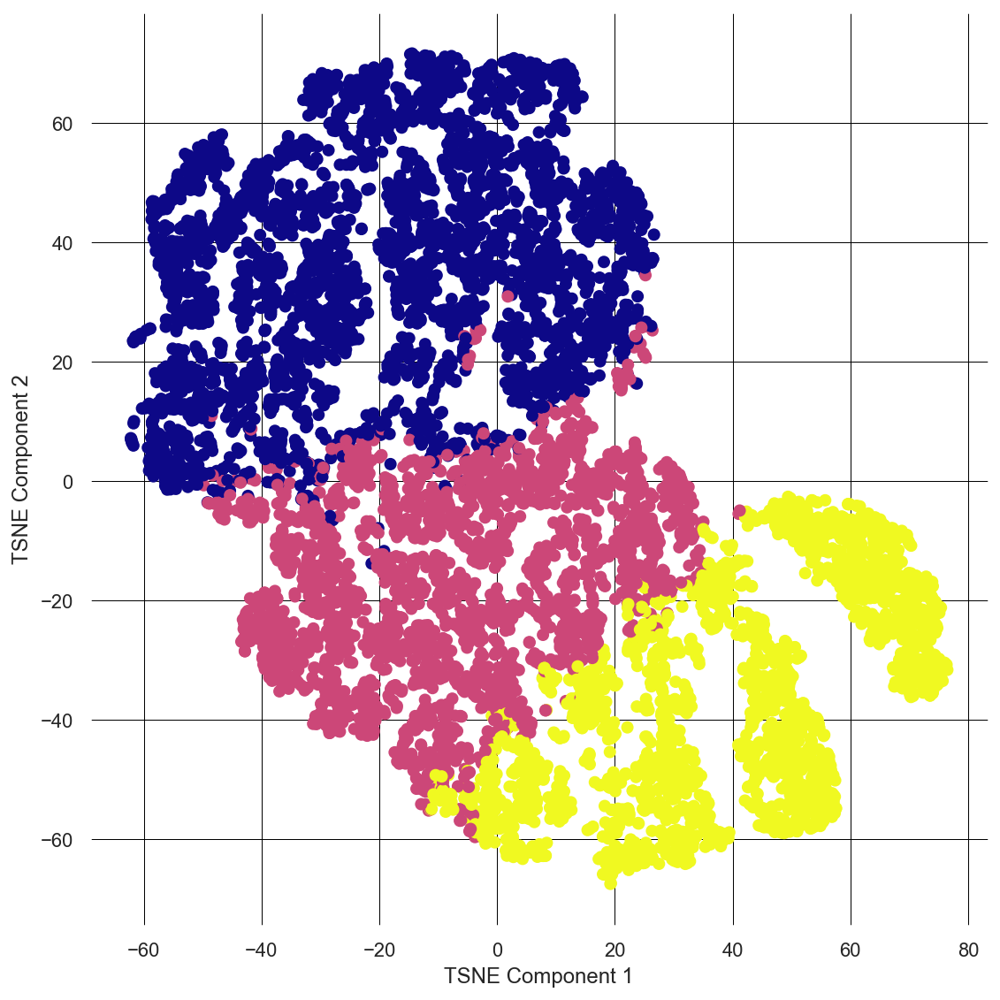

In [168]:
visualize_clusters(clientprofile_cluster_labels, 'MS_Clust', clientprofile_variables_metric)

### 4.1.3 Agglomerative Hierarchical Clustering

#### 4.1.3.1 Average Linkage

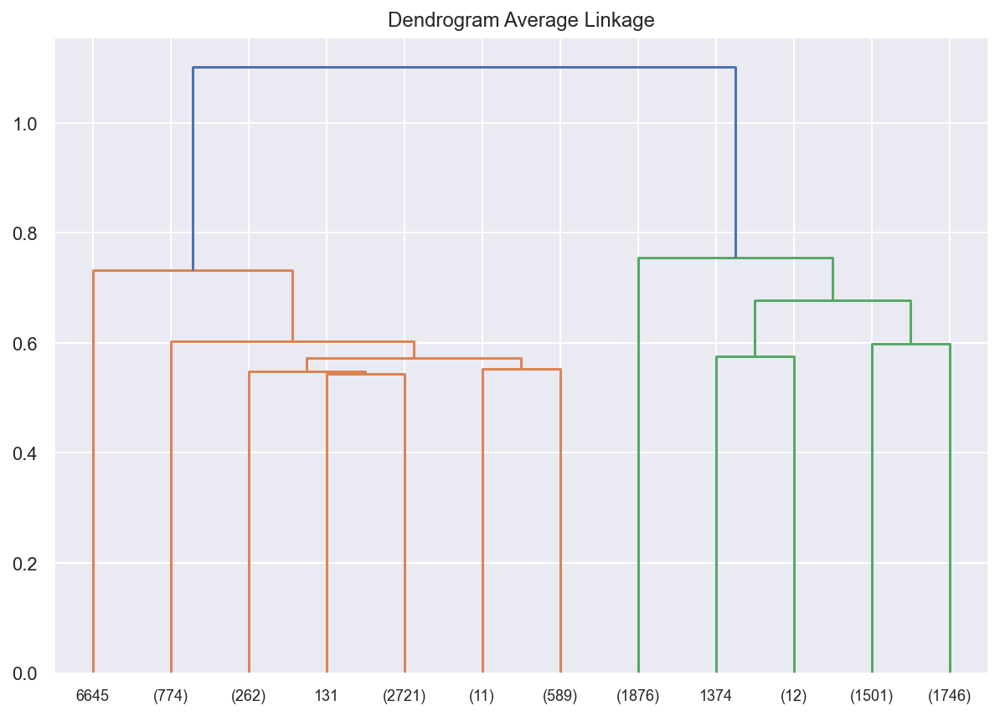

In [169]:
#plotting dendogram for hierarchical clustering with average linkage
plt.figure(figsize=(10, 7))  
plt.title("Dendrogram Average Linkage")  
dend = shc.dendrogram(shc.linkage(clientprofile_cluster, method='average'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)

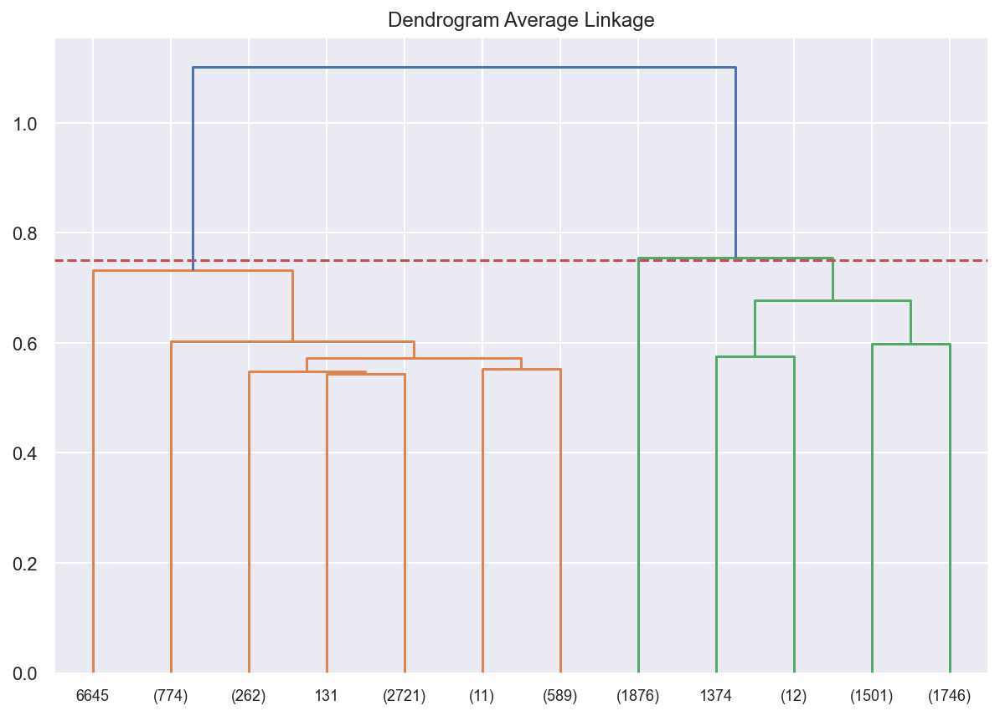

In [170]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrogram Average Linkage")  
dend = shc.dendrogram(shc.linkage(clientprofile_cluster, method='average', metric='euclidean'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)
plt.axhline(y=0.75, color='r', linestyle='--')

We choose max distance 0.75. We will consider 3 distinct groups.

We see this distance as a good limit to indicate the group's division.

* [Average Linkage Client Profile Checkpoint (Ref)](#decision_clust_cp) </font> <a class="anchor" id="averagelinkage_cp"></a>

In [171]:
clusters_al_cp = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='average')  
al_labels_cp = clusters_al_cp.fit_predict(clientprofile_cluster)
clientprofile_cluster_labels['AL_Clust'] = al_labels_cp
clientprofile_cluster_realvalues['AL_Clust'] = al_labels_cp

TypeError: __init__() got an unexpected keyword argument 'metric'

**Let's have a look at some brief statistics for our clusters.**

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').mean()[clientprofile_variables_metric]

*Variable Age*

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').describe()['Age']

*Variable Income*

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').describe()['Income']

*Variable AVRPUR*

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').describe()['AVRPUR']

*Variable LTV*

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').describe()['LTV']

*Variable Perdeal*

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').describe()['Perdeal']

*Variable WebPurchase*

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').describe()['WebPurchase']

*Variable WebVisit*

In [ ]:
clientprofile_cluster_realvalues.groupby('AL_Clust').describe()['WebVisit']

**We look at the clusters weights.**

In [ ]:
clientprofile_cluster_realvalues.AL_Clust.value_counts(normalize = True)

**Lets have a look at the radar graph and the variables' distribution.**

In [ ]:
create_radar_graph(clientprofile_cluster_labels, clientprofile_variables_metric, 'AL_Clust')

In [ ]:
b = clientprofile_cluster_labels.groupby('AL_Clust').mean()

#sns.set(font_scale=1.7)
fig, axes = plt.subplots(4, 2, figsize=(25, 30))
for ax, feat in zip(axes.flatten(), b[clientprofile_variables_metric]):
    sns.barplot(x=b.index, y=feat, data=b, ax=ax, palette='Set2')
    
title = "Profilling Value Clusters"
plt.suptitle(title, size= 30)
plt.show()

**We finish by displaying a 2d plot clusters representation after a TSNE transformation.**

In [ ]:
visualize_clusters(clientprofile_cluster_labels, 'AL_Clust', clientprofile_variables_metric)

#### 4.1.3.2 Ward Linkage

In [ ]:
#plotting dendogram for hierarchical clustering with centroid linkage
plt.figure(figsize=(12, 8))  
plt.title("Dendrogram Centroid Linkage")  
dend = shc.dendrogram(shc.linkage(clientprofile_cluster, method='ward'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)

In [ ]:
#plotting dendogram for hierarchical clustering with ward linkage
plt.figure(figsize=(12, 8))  
plt.title("Dendrogram Centroid Linkage")  
dend = shc.dendrogram(shc.linkage(clientprofile_cluster, method='ward'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)
plt.axhline(y=25, color='r', linestyle='--')

**We choose max variance 25. We will consider 3 distinct groups.**

We see this distance as a good limit to indicate the group's division.

In [ ]:
clusters_w_cp = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='ward')  
w_labels_cp = clusters_w_cp.fit_predict(clientprofile_cluster)
clientprofile_cluster_labels['Ward_Clust'] = w_labels_cp
clientprofile_cluster_realvalues['Ward_Clust'] = w_labels_cp

**Let's have a look at some brief statistics for our clusters**

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').mean()[clientprofile_variables_metric]

*Variable Age*

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').describe()['Age']

*Variable Income*

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').describe()['Income']

*Variable AVRPUR*

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').describe()['AVRPUR']

*Variable LTV*

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').describe()['LTV']

*Variable Perdeal*

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').describe()['Perdeal']

*Variable WebPurchase*

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').describe()['WebPurchase']

*Variable WebVisit*

In [ ]:
clientprofile_cluster_realvalues.groupby('Ward_Clust').describe()['WebVisit']

**We look at the clusters weights.**

In [ ]:
clientprofile_cluster_realvalues.Ward_Clust.value_counts(normalize = True)

**Lets have a look at the radar graph and the variables' distribution.**

In [ ]:
create_radar_graph(clientprofile_cluster_labels, clientprofile_variables_metric, 'Ward_Clust')

In [ ]:
b = clientprofile_cluster_labels.groupby('Ward_Clust').mean()

#sns.set(font_scale=1.7)
fig, axes = plt.subplots(3, 2, figsize=(25, 30))
for ax, feat in zip(axes.flatten(), b[clientprofile_variables_metric]):
    sns.barplot(x=b.index, y=feat, data=b, ax=ax, palette='Set2')
    
title = "Profilling Value Clusters"
plt.suptitle(title, size= 30)
plt.show()

**We finish by displaying a 2d plot clusters representation after a TSNE transformation.**

In [ ]:
visualize_clusters(clientprofile_cluster_labels, 'Ward_Clust', clientprofile_variables_metric)

### 4.1.4 DBSCAN

In [ ]:
dbclust_cp = DBSCAN(eps = 0.25 ,min_samples = 22).fit(clientprofile_cluster)

n_clusters_dbscan_cp = len(set(dbclust_cp.labels_)) - (1 if -1 in dbclust_cp.labels_ else 0)
n_noise_dbscan_cp = list(dbclust_cp.labels_).count(-1)

print('Cluster Predictions')
print('-------------------------------')
print("Number of clusters: %d" % n_clusters_dbscan_cp)
print("Number of noise points: %d" % n_noise_dbscan_cp)
print('Number of points per cluster:')
for i in range(n_clusters_dbscan_cp):
    print('Cluster', i, ':', len(dbclust_cp.labels_[dbclust_cp.labels_==i]))

**After trying with several distances and minimal points, we abandoned this method**

### 4.1.5 Decision and Outliers' Dataset Re-Introduction

After analysing all of the outcomes, the group seems that the one with a more feasible and possible valuable solution is the
**Agglomerative Hierarchical with Average Linkage**

* [Agglomerative Hierarchical with Average Linkage (Ref)](#averagelinkage_cp) </font> <a class="anchor" id="decision_clust_cp"></a>

In [ ]:
clientprofile_segmentation = clientprofile_cluster_realvalues.drop(columns=['KM_Clust','MS_Clust','Ward_Clust'])
clientprofile_segmentation[['Kidhome']] = clientprofile_dataset[['Kidhome']]
clientprofile_segmentation.rename(columns={'AL_Clust':'CP'},inplace=True)
clientprofile_segmentation_normalized = clientprofile_cluster.copy()
clientprofile_segmentation_normalized[['Kidhome']] = clientprofile_dataset[['Kidhome']]
clientprofile_segmentation_normalized[['CP']] = clientprofile_segmentation[['CP']]

In [ ]:
clientprofile_segmentation.groupby('CP').mean()

**We use a PCA components dataframe transformation in order to again visualize the clusters. We do this for both 2 and 3 components.**

In [ ]:
plot_pca(clientprofile_segmentation_normalized, 'CP', clientprofile_variables_metric)

**We also assemble heatmaps for a better clusters' comprehension.**

In [ ]:
plot_heatmap(clientprofile_segmentation_normalized, 'CP',clientprofile_variables_metric)

## 4.2 Buying Behaviour

In [ ]:
#checking variables list
buyingbehaviour_variables_metric

In [ ]:
# for graphic presentation purposes
buyingbehaviour_cluster_labels = buyingbehaviour_cluster.copy()

### 4.2.1 K Means

**We begin by checking the 'ideally desired' number of clusters using the PCA process.**

In [ ]:
# creating a PCA instance 
pca_bb = PCA(n_components = 8)
principalComponents_bb = pca_bb.fit_transform(buyingbehaviour_cluster)

# saving components to a DataFrame
PCA_components_bb = pd.DataFrame(principalComponents_bb)

#finding the number of clusters
ks = range(1, 20)
inertias = []
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    model.fit(PCA_components_bb.iloc[:,:3])
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
plt.plot(ks, inertias, '-o', color='red')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()

In [ ]:
plt.plot(ks, inertias, '-o', color='red')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.axvline(x=4, color='r', linestyle='--')
plt.show()

We choose to segment clients into 4 different groups, following the "elbow rule"

* [K-Means Buying Behaviour Checkpoint](#decision_bb) </font> <a class="anchor" id="kmeans_bb"></a>

Clustering the records...

In [ ]:
buyingbehaviour_kmclust = KMeans(n_clusters=4, init='k-means++', n_init=20, random_state=1)
buyingbehaviour_kmclust.fit(buyingbehaviour_cluster)

In [ ]:
clusters_km_bb = buyingbehaviour_kmclust.predict(buyingbehaviour_cluster)

In [ ]:
buyingbehaviour_cluster_realvalues['KM_Clust'] = clusters_km_bb
buyingbehaviour_cluster_labels['KM_Clust'] = clusters_km_bb

**Let's look at some brief statistics for our clusters**

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').mean()[buyingbehaviour_variables_metric]

*Variable Age*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Age']

*Variable Educ*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Educ']

*Variable Dryred*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Dryred']

*Variable Sweetred*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Sweetred']

*Variable Drywh*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Drywh']

*Variable Sweetwh*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Sweetwh']

*Variable Dessert*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Dessert']

*Variable Exotic*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Exotic']

**We look at the clusters weights.**

In [ ]:
buyingbehaviour_cluster_realvalues.KM_Clust.value_counts(normalize = True)

**Let's have a look at the radar graph and the variables' distribution.**

In [ ]:
create_radar_graph(buyingbehaviour_cluster_labels, buyingbehaviour_variables_metric, 'KM_Clust')

In [ ]:
b = buyingbehaviour_cluster_labels.groupby('KM_Clust').mean()

#sns.set(font_scale=1.7)
fig, axes = plt.subplots(3, 3, figsize=(25, 30))
for ax, feat in zip(axes.flatten(), b[buyingbehaviour_variables_metric]):
    sns.barplot(x=b.index, y=feat, data=b, ax=ax, palette='Set2')
    
title = "Profilling Value Clusters"
plt.suptitle(title, size= 30)
plt.show()

**We finish by displaying a 2d plot clusters representation after a TSNE transformation.**

In [ ]:
visualize_clusters(buyingbehaviour_cluster_labels, 'KM_Clust', buyingbehaviour_variables_metric)

### 4.2.2 Mean Shift

In [ ]:
# The following bandwidth can be automatically detected using (we need to set quantile though)
# Based on distance to nearest neighbors for all observations
bandwidth_bb = estimate_bandwidth(buyingbehaviour_cluster, quantile=0.2, random_state=1, n_jobs=-1)
bandwidth_bb

In [ ]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms_bb = MeanShift(bandwidth=bandwidth_bb, bin_seeding=True, n_jobs=4)
ms_labels_bb = ms_bb.fit_predict(buyingbehaviour_cluster)

ms_n_clusters_bb = len(np.unique(ms_labels_bb))
print("Number of estimated clusters : %d" % ms_n_clusters_bb)

**After trying different quantiles for the bandwith, we decided to abandon this route.**

### 4.2.3 Agglomerative Hierarchical Clustering

#### 4.2.3.1 Average Linkage

In [ ]:
#plotting dendogram for hierarchical clustering with average linkage
plt.figure(figsize=(10, 7))  
plt.title("Dendrogram Average Linkage")  
dend = shc.dendrogram(shc.linkage(buyingbehaviour_cluster, method='average'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)

In [ ]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrogram Average Linkage")  
dend = shc.dendrogram(shc.linkage(buyingbehaviour_cluster, method='average'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)
plt.axhline(y=0.9, color='r', linestyle='--')

We choose max distance 0.9. We will consider 5 distinct groups.

We see this distance as a good limit to indicate the group's division

In [ ]:
clusters_al_bb = AgglomerativeClustering(n_clusters=5, metric='euclidean', linkage='average')  
buyingbehaviour_cluster_realvalues['AL_Clust'] = clusters_al_bb.fit_predict(buyingbehaviour_cluster)
buyingbehaviour_cluster_labels['AL_Clust']= clusters_al_bb.fit_predict(buyingbehaviour_cluster)

**Let's look at some brief statistics for our clusters**

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('AL_Clust').mean()[buyingbehaviour_variables_metric]

*Variable Age*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('AL_Clust').describe()['Age']

*Variable Educ*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('AL_Clust').describe()['Educ']

*Variable Dryred*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('AL_Clust').describe()['Dryred']

*Variable Sweetred*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('AL_Clust').describe()['Sweetred']

*Variable Drywh*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('AL_Clust').describe()['Drywh']

*Variable Sweetwh*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Sweetwh']

*Variable Dessert*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Dessert']

*Variable Exotic*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('KM_Clust').describe()['Exotic']

In [ ]:
buyingbehaviour_cluster_realvalues.AL_Clust.value_counts(normalize = True)

**Let's have a look at the radar graph and the variables' distribution.**

In [ ]:
create_radar_graph(buyingbehaviour_cluster_labels, buyingbehaviour_variables_metric, 'AL_Clust')

In [ ]:
b = buyingbehaviour_cluster_labels.groupby('AL_Clust').mean()

#sns.set(font_scale=1.7)
fig, axes = plt.subplots(3, 2, figsize=(25, 30))
for ax, feat in zip(axes.flatten(), b[buyingbehaviour_variables_metric]):
    sns.barplot(x=b.index, y=feat, data=b, ax=ax, palette='Set2')
    
title = "Profilling Value Clusters"
plt.suptitle(title, size= 30)
plt.show()

**We finish by displaying a 2d plot clusters representation after a TSNE transformation.**

In [ ]:
visualize_clusters(buyingbehaviour_cluster_labels, 'AL_Clust', buyingbehaviour_variables_metric)

#### 4.2.3.2 Ward Linkage

In [ ]:
#plotting dendogram for hierarchical clustering with ward linkage
plt.figure(figsize=(10, 7))  
plt.title("Dendrogram Centroid Linkage")  
dend = shc.dendrogram(shc.linkage(buyingbehaviour_cluster, method='ward'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)

In [ ]:
#plotting dendogram for hierarchical clustering with ward linkage
plt.figure(figsize=(10, 7))  
plt.title("Dendrogram Centroid Linkage")  
dend = shc.dendrogram(shc.linkage(buyingbehaviour_cluster, method='ward'),truncate_mode = 'lastp', p=12, leaf_rotation=0,leaf_font_size=9)
plt.axhline(y=15, color='r', linestyle='--')

**We choose max variance 15. We will consider 5 distinct groups.**

We see this distance as a good limit to indicate the group's division.

In [ ]:
clusters_w_bb = AgglomerativeClustering(n_clusters=5, metric='euclidean', linkage='ward')  
w_labels_bb = clusters_al_cp.fit_predict(buyingbehaviour_cluster)
buyingbehaviour_cluster_labels['Ward_Clust'] = w_labels_bb
buyingbehaviour_cluster_realvalues['Ward_Clust'] = w_labels_bb

**Let's have a look at some brief statistics for our clusters**

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').mean()[buyingbehaviour_variables_metric]

*Variable Age*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Age']

*Variable Educ*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Educ']

*Variable Dryred*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Dryred']

*Variable Sweetred*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Sweetred']

*Variable Drywh*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Drywh']

*Variable Sweetwh*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Sweetwh']

*Variable Dessert*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Dessert']

*Variable Exotic*

In [ ]:
buyingbehaviour_cluster_realvalues.groupby('Ward_Clust').describe()['Exotic']

In [ ]:
buyingbehaviour_cluster_realvalues.Ward_Clust.value_counts(normalize = True)

**Let's have a look at the radar graph and the variables' distribution.**

In [ ]:
create_radar_graph(buyingbehaviour_cluster_labels, buyingbehaviour_variables_metric, 'Ward_Clust')

In [ ]:
b = buyingbehaviour_cluster_labels.groupby('Ward_Clust').mean()

#sns.set(font_scale=1.7)
fig, axes = plt.subplots(3, 2, figsize=(25, 30))
for ax, feat in zip(axes.flatten(), b[buyingbehaviour_variables_metric]):
    sns.barplot(x=b.index, y=feat, data=b, ax=ax, palette='Set2')
    
title = "Profilling Value Clusters"
plt.suptitle(title, size= 30)
plt.show()

**We finish by displaying a 2d plot clusters representation after a TSNE transformation.**

In [ ]:
visualize_clusters(buyingbehaviour_cluster_labels, 'Ward_Clust', buyingbehaviour_variables_metric)

### 4.2.4 DBSCAN

In [ ]:
dbclust_bb = DBSCAN(eps = 0.18 ,min_samples = 500).fit(buyingbehaviour_cluster)

n_clusters_dbscan_bb = len(set(dbclust_bb.labels_)) - (1 if -1 in dbclust_bb.labels_ else 0)
n_noise_dbscan_bb = list(dbclust_bb.labels_).count(-1)

print('Cluster Predictions')
print('-------------------------------')
print("Number of clusters: %d" % n_clusters_dbscan_bb)
print("Number of noise points: %d" % n_noise_dbscan_bb)
print('Number of points per cluster:')
for i in range(n_clusters_dbscan_bb):
    print('Cluster', i, ':', len(dbclust_bb.labels_[dbclust_bb.labels_==i]))

**After trying with several distances and minimal points, we abandoned this method**

plt.figure(figsize=(20,5))
plt.subplot(1,4,1)
sns.scatterplot(x = pca_flavor_feeling['f1'], y = pca_flavor_feeling['f2'], hue=kmeans_labels)
plt.title('KMeans')

plt.subplot(1,4,2)
birch = sns.scatterplot(x = pca_flavor_feeling['f1'], y = pca_flavor_feeling['f2'], hue=labels_b)
plt.title('Avr Linkage')

plt.suptitle("Visualization of clusters in 2 dimensions", fontsize=20)

plt.show()

### 4.2.5 Decision

After analysing all of the outcomes, the group seems that the one with a more feasible and possible valuable solution is the
**K Means Clustering Process**.

* [K-Means Method (Ref)](#kmeans_bb) </font> <a class="anchor" id="decision_bb"></a>

In [ ]:
buyingbehaviour_segmentation = buyingbehaviour_cluster_realvalues.drop(columns=['AL_Clust','Ward_Clust'])
buyingbehaviour_segmentation[['Teenhome']] = buyingbehaviour_dataset[['Teenhome']]
buyingbehaviour_segmentation.rename(columns={'KM_Clust':'BB'},inplace=True)
buyingbehaviour_segmentation_normalized = buyingbehaviour_cluster.copy()
buyingbehaviour_segmentation_normalized[['Teenhome']] = buyingbehaviour_dataset[['Teenhome']]
buyingbehaviour_segmentation_normalized[['BB']] = buyingbehaviour_segmentation[['BB']]

In [ ]:
buyingbehaviour_segmentation.groupby('BB').mean()

**We use a PCA components dataframe transformation in order to again visualize the clusters. We do this for both 2 and 3 components.**

In [ ]:
plot_pca(buyingbehaviour_segmentation_normalized, 'BB', buyingbehaviour_variables_metric)

**We also assemble heatmaps for a better clusters' comprehension.**

In [ ]:
plot_heatmap(buyingbehaviour_segmentation_normalized, 'BB', buyingbehaviour_variables_metric)

# <font color='#5E2190'>5. Merging Both Cluster Segmentations </font> <a class="anchor" id="Merge"></a>

**Merging segmentations achieved on chapter 4.**

[To Index](#toc) 

**We begin be merging the two segmentations. We also merged the normalized data for a better data visualization when defining the target groups.**

In [ ]:
WWW_segmentation = clientprofile_segmentation.copy()

In [ ]:
WWW_segmentation_normalized = clientprofile_dataset_minmax.copy()

In [ ]:
WWW_segmentation[['Educ','Teenhome','Dryred','Sweetred','Drywh','Sweetwh','Dessert','Exotic','BB']] = buyingbehaviour_segmentation[['Educ','Teenhome','Dryred','Sweetred','Drywh','Sweetwh','Dessert','Exotic','BB']]
WWW_segmentation_normalized[['Educ','Dryred','Sweetred','Drywh','Sweetwh','Dessert','Exotic']] = buyingbehaviour_dataset_minmax[['Educ','Dryred','Sweetred','Drywh','Sweetwh','Dessert','Exotic']]

In [ ]:
www_variables = sorted(list(set(clientprofile_variables_metric + buyingbehaviour_variables_metric))) + ['Kidhome'] + ['Teenhome']
www_variables_metric = sorted(list(set(clientprofile_variables_metric + buyingbehaviour_variables_metric)))

In [ ]:
WWW_segmentation.groupby(['CP', 'BB'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('BB', 'CP', 0)

**Now, we create the final segments by merging the previously assembled clusters.**

**We'll presumably have 12 different groups (3 Client Profile x 4 Buying Behaviour).**

In [ ]:
WWW_segmentation_auxiliary = WWW_segmentation.groupby(['CP', 'BB'])[www_variables].mean()

In [ ]:
WWW_segmentation_auxiliary['Final_Cluster'] = np.arange(WWW_segmentation_auxiliary.shape[0])

In [ ]:
labels_map = WWW_segmentation_auxiliary['Final_Cluster'].to_dict()
labels_map

**There is a group with no members. So the Final Clusters are 11 in total.**

In [ ]:
WWW_segmentation = manual_mapper(WWW_segmentation, 'CP', 'BB', 'Final_Cluster', labels_map)
WWW_segmentation_normalized[['CP']] = WWW_segmentation[['CP']]
WWW_segmentation_normalized[['BB']] = WWW_segmentation[['BB']]
WWW_segmentation_normalized[['Final_Cluster']] = WWW_segmentation[['Final_Cluster']]
WWW_segmentation

**We count the number of records within each cluster and look into the clusters in both 2D and 3D using 2 and 3 PCA components, respectively.** 

In [ ]:
WWW_segmentation['Final_Cluster'].value_counts()

In [ ]:
plot_pca(WWW_segmentation, 'Final_Cluster' , www_variables_metric)

# <font color='#5E2190'>6. Deciding the Target Groups </font> <a class="anchor" id="Comment"></a>
**We can judge the book by its cover on this one ;)**

[To Index](#toc) 

In [ ]:
WWW_segmentation.groupby('Final_Cluster').mean()[www_variables]

In [ ]:
WWW_segmentation.groupby('Final_Cluster')['Final_Cluster'].count()

**We'll reassign the clusters with less members to their pairs.**

**We reassing clusters 3, 5, 6, 8 and 9 using a Decision Tree.**

In [ ]:
labels_to_include = [3, 5, 6, 8, 9]
indexes = WWW_segmentation[WWW_segmentation['Final_Cluster'].isin(labels_to_include)].index.tolist()

**We train the decision tree with the other clusters' data.**

In [ ]:
reassign = WWW_segmentation[www_variables].loc[indexes]
train = WWW_segmentation.drop(indexes).copy()
target = train['Final_Cluster']
#reassign.drop(columns = {'Final_Cluster','CP','BB'},inplace = True)
train = train[www_variables]
#train.drop(columns = {'Final_Cluster','CP','BB'},inplace = True)


In [ ]:
X_train, X_val, y_train, y_val = train_test_split(train, target, test_size=0.3, random_state=42)

In [ ]:
WWW_reassign = DecisionTreeClassifier().fit(X_train,y_train) 

In [ ]:
accuracy_score(y_val,WWW_reassign.predict(X_val))

**We reassign the clusters.**

In [ ]:
labels = WWW_reassign.predict(reassign)

In [ ]:
WWW_segmentation.Final_Cluster.loc[indexes] = labels

In [ ]:
all_labels = WWW_segmentation['Final_Cluster']

In [ ]:
WWW_segmentation = WWW_segmentation[www_variables]

In [ ]:
WWW_segmentation['Final_Cluster'] = all_labels

In [ ]:
WWW_segmentation.loc[indexes]

In [ ]:
WWW_segmentation.groupby('Final_Cluster').size()

In [ ]:
WWW_segmentation.groupby('Final_Cluster').mean()[www_variables]

**We classify the outliers based on the existing clusters.**

In [ ]:
reassign_outliers=outliers_dataset[www_variables].copy()

In [ ]:
reassign_outliers

In [ ]:
labels_outliers = WWW_reassign.predict(reassign_outliers)

In [ ]:
outliers_dataset = outliers_dataset[www_variables]

In [ ]:
outliers_dataset['Final_Cluster'] = labels_outliers

In [ ]:
outliers_dataset.groupby('Final_Cluster').size()

**We reintroduce the outliers in the dataset.**

In [ ]:
WWW_segmentation = pd.concat([WWW_segmentation, outliers_dataset])

In [ ]:
WWW_segmentation.reset_index(inplace = True, drop=True)

In [ ]:
WWW_segmentation

In [ ]:
WWW_segmentation.groupby('Final_Cluster').size()

In [ ]:
WWW_segmentation.groupby('Final_Cluster').mean()

**We are ready to rename the target groups and end our pleasant journey (:**

In [ ]:
WWW_segmentation.Final_Cluster = WWW_segmentation.Final_Cluster.replace(0,'Discount_Lovers')
WWW_segmentation.Final_Cluster = WWW_segmentation.Final_Cluster.replace(1,'Young_and_Broke')
WWW_segmentation.Final_Cluster = WWW_segmentation.Final_Cluster.replace(2,'Life_is_Sweet')
WWW_segmentation.Final_Cluster = WWW_segmentation.Final_Cluster.replace(4,'Sugar_Daddy')
WWW_segmentation.Final_Cluster = WWW_segmentation.Final_Cluster.replace(7,'Everything_Dry')
WWW_segmentation.Final_Cluster = WWW_segmentation.Final_Cluster.replace(10,'Sugar_GrandDaddy')

In [ ]:
WWW_segmentation.groupby('Final_Cluster').mean()

**We landed on time. Thank you for flying with group 049.**